In [7]:
import torch
from torch import nn
import torchvision

import Utils

In [8]:
BATCH_SIZE = 128
IMAGE_CHANNEL = 3
X_DIM = 32
LATENT_DIM = 100
G_HIDDEN = 128
D_HIDDEN = 128
EPOCH_NUM = 250
NUM_CLASSES = 10
lr_d = 0.0001
lr_g = 0.0001

In [9]:
device = Utils.get_device()
dataloader = Utils.get_loader(torchvision.datasets.CIFAR10, X_DIM, BATCH_SIZE)

Using device: cuda
Data loaded


## Sample images from the dataset

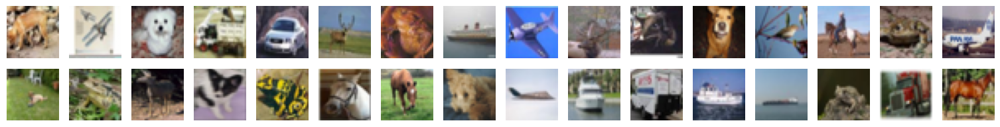

In [5]:
Utils.plot_real(dataloader)

## Model Architecture and Configuration

In [10]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0., 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [11]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        self.main = nn.Sequential(
            # input layer
            nn.ConvTranspose2d(LATENT_DIM + NUM_CLASSES, G_HIDDEN * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(G_HIDDEN * 8),
            nn.ReLU(inplace=True),  # shape: (G_HIDDEN * 8, 4, 4)
            # 1st layer
            nn.ConvTranspose2d(G_HIDDEN * 8, G_HIDDEN * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(G_HIDDEN * 4),
            nn.ReLU(inplace=True),  # shape: (G_HIDDEN * 4, 8, 8)
            # 2nd hidden layer
            nn.ConvTranspose2d(G_HIDDEN * 4, G_HIDDEN * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(G_HIDDEN * 2),
            nn.ReLU(inplace=True),  # shape: (G_HIDDEN * 2, 16, 16)
            # 3rd hidden layer
            nn.ConvTranspose2d(G_HIDDEN * 2, G_HIDDEN, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(G_HIDDEN),
            nn.ReLU(inplace=True),  # shape: (G_HIDDEN, 32, 32)
            # output layer
            nn.Conv2d(G_HIDDEN, IMAGE_CHANNEL, kernel_size=3, stride=1, padding=1, bias=False),
            nn.Tanh()  # shape: (IMAGE_CHANNEL, 32, 32)
        )   
    
    def forward(self, z, labels):
        label_emb = self.label_emb(labels).unsqueeze(2).unsqueeze(3)  # (batch_size, NUM_CLASSES, 1, 1) 
        x = torch.cat([z, label_emb], dim=1) 
        return self.main(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.label_emb = nn.Embedding(NUM_CLASSES, NUM_CLASSES)
        self.main = nn.Sequential(
            # 1st layer
            nn.Conv2d(IMAGE_CHANNEL + NUM_CLASSES, D_HIDDEN, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),  # shape: (D_HIDDEN, 16, 16)
            # 2nd layer
            nn.Conv2d(D_HIDDEN, D_HIDDEN * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(D_HIDDEN * 2),
            nn.LeakyReLU(0.2, inplace=True),  # shape: (D_HIDDEN * 2, 8, 8)
            # 3rd layer
            nn.Conv2d(D_HIDDEN * 2, D_HIDDEN * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(D_HIDDEN * 4),
            nn.LeakyReLU(0.2, inplace=True),  # shape: (D_HIDDEN * 4, 4, 4)
            # output layer
            nn.Conv2d(D_HIDDEN * 4, 1, kernel_size=4, stride=1, padding=0, bias=False)
            # shape: (1, 1, 1)
        )

    def forward(self, img, labels):
        label_emb = self.label_emb(labels).unsqueeze(2).unsqueeze(3)
        label_emb = label_emb.expand(-1, -1, X_DIM, X_DIM)
        x = torch.cat([img, label_emb], dim=1)
        return self.main(x).view(-1, 1).squeeze(1)

In [13]:
netG = Generator().to(device)
netG.apply(weights_init)
print('Number of parameters in the generator:', Utils.get_n_params(netG))

netD = Discriminator().to(device)
netD.apply(weights_init)
print('Number of parameters in the discriminator:', Utils.get_n_params(netD))

criterion = nn.BCEWithLogitsLoss()
viz_noise = torch.randn(BATCH_SIZE, LATENT_DIM, 1, 1, device=device)
viz_labels = torch.randint(0, NUM_CLASSES, (BATCH_SIZE,), device=device)

optimizerD = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(0.5, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(0.5, 0.999))

Number of parameters in the generator: 12819684
Number of parameters in the discriminator: 2657892


## Training loop

[1/250][150/391]	Loss_D: 0.8537	Loss_G: 3.1599	D(x): 1.6325	D(G(z)): -0.8327 / -3.1016
[1/250][300/391]	Loss_D: 0.8222	Loss_G: 2.9510	D(x): 1.9425	D(G(z)): -0.2317 / -2.8889
[2/250][150/391]	Loss_D: 1.5231	Loss_G: 0.9603	D(x): -0.2135	D(G(z)): -0.1715 / -0.4287
[2/250][300/391]	Loss_D: 1.3597	Loss_G: 1.0639	D(x): 0.1953	D(G(z)): -0.0807 / -0.5931
[3/250][150/391]	Loss_D: 1.2773	Loss_G: 1.0357	D(x): 0.1438	D(G(z)): -0.2418 / -0.5636
[3/250][300/391]	Loss_D: 1.3378	Loss_G: 0.8046	D(x): 0.0606	D(G(z)): -0.1441 / -0.1619
[4/250][150/391]	Loss_D: 1.4688	Loss_G: 0.8099	D(x): -0.0007	D(G(z)): 0.0044 / -0.1804
[4/250][300/391]	Loss_D: 1.3209	Loss_G: 0.7866	D(x): 0.0774	D(G(z)): -0.1497 / -0.1524
[5/250][150/391]	Loss_D: 1.4626	Loss_G: 0.9837	D(x): -0.0123	D(G(z)): 0.0444 / -0.4890
[5/250][300/391]	Loss_D: 1.3366	Loss_G: 1.1482	D(x): 0.2842	D(G(z)): 0.0580 / -0.7348


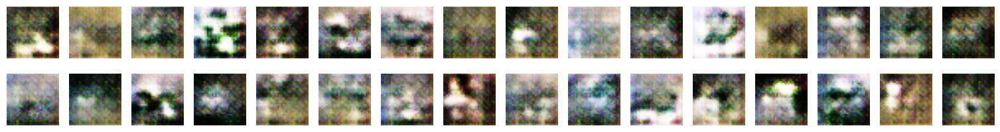

[6/250][150/391]	Loss_D: 1.2782	Loss_G: 0.9808	D(x): 0.0319	D(G(z)): -0.2772 / -0.4845
[6/250][300/391]	Loss_D: 1.3325	Loss_G: 1.0164	D(x): 0.3941	D(G(z)): 0.1463 / -0.5419
[7/250][150/391]	Loss_D: 1.3720	Loss_G: 0.8162	D(x): 0.0127	D(G(z)): -0.0994 / -0.2018
[7/250][300/391]	Loss_D: 1.3927	Loss_G: 0.8638	D(x): 0.2714	D(G(z)): 0.1641 / -0.2883
[8/250][150/391]	Loss_D: 1.3948	Loss_G: 0.8096	D(x): 0.0204	D(G(z)): -0.0203 / -0.1973
[8/250][300/391]	Loss_D: 1.3830	Loss_G: 0.8456	D(x): -0.2232	D(G(z)): -0.3301 / -0.2642
[9/250][150/391]	Loss_D: 1.4391	Loss_G: 0.8371	D(x): -0.0338	D(G(z)): 0.0067 / -0.2467
[9/250][300/391]	Loss_D: 1.3919	Loss_G: 0.7878	D(x): 0.1096	D(G(z)): 0.0790 / -0.1647
[10/250][150/391]	Loss_D: 1.3234	Loss_G: 0.9416	D(x): 0.1543	D(G(z)): -0.0299 / -0.4233
[10/250][300/391]	Loss_D: 1.3365	Loss_G: 0.9046	D(x): 0.1540	D(G(z)): -0.0158 / -0.3672


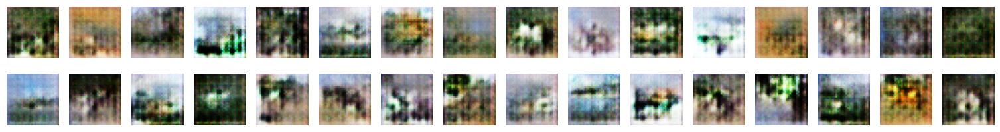

[11/250][150/391]	Loss_D: 1.3112	Loss_G: 0.9006	D(x): -0.0688	D(G(z)): -0.3296 / -0.3489
[11/250][300/391]	Loss_D: 1.3766	Loss_G: 0.8362	D(x): 0.0075	D(G(z)): -0.0721 / -0.2492
[12/250][150/391]	Loss_D: 1.3787	Loss_G: 0.9812	D(x): 0.2110	D(G(z)): 0.0824 / -0.4786
[12/250][300/391]	Loss_D: 1.4186	Loss_G: 0.9539	D(x): 0.1472	D(G(z)): 0.1257 / -0.4392
[13/250][150/391]	Loss_D: 1.3854	Loss_G: 0.9500	D(x): 0.1446	D(G(z)): 0.0491 / -0.4346
[13/250][300/391]	Loss_D: 1.3979	Loss_G: 0.8620	D(x): 0.2171	D(G(z)): 0.1276 / -0.2714
[14/250][150/391]	Loss_D: 1.4688	Loss_G: 0.9018	D(x): 0.1287	D(G(z)): 0.2011 / -0.3496
[14/250][300/391]	Loss_D: 1.4695	Loss_G: 0.7367	D(x): -0.4911	D(G(z)): -0.6030 / -0.0476
[15/250][150/391]	Loss_D: 1.3965	Loss_G: 0.8235	D(x): -0.0222	D(G(z)): -0.0412 / -0.2309
[15/250][300/391]	Loss_D: 1.4334	Loss_G: 0.8389	D(x): 0.0353	D(G(z)): 0.0657 / -0.2575


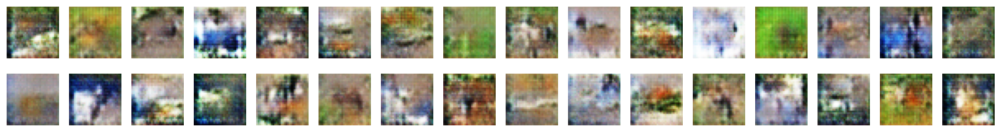

[16/250][150/391]	Loss_D: 1.3433	Loss_G: 0.7648	D(x): -0.1065	D(G(z)): -0.2806 / -0.1118
[16/250][300/391]	Loss_D: 1.4501	Loss_G: 0.8210	D(x): -0.0981	D(G(z)): -0.0386 / -0.2135
[17/250][150/391]	Loss_D: 1.3866	Loss_G: 1.0126	D(x): 0.0524	D(G(z)): -0.0199 / -0.5433
[17/250][300/391]	Loss_D: 1.3815	Loss_G: 0.8132	D(x): 0.1292	D(G(z)): 0.0546 / -0.2050
[18/250][150/391]	Loss_D: 1.4899	Loss_G: 0.7188	D(x): -0.0793	D(G(z)): 0.0392 / -0.0216
[18/250][300/391]	Loss_D: 1.3197	Loss_G: 0.8338	D(x): 0.0354	D(G(z)): -0.1771 / -0.2405
[19/250][150/391]	Loss_D: 1.3566	Loss_G: 0.8396	D(x): 0.0564	D(G(z)): -0.0548 / -0.2528
[19/250][300/391]	Loss_D: 1.3255	Loss_G: 0.7224	D(x): -0.0435	D(G(z)): -0.2285 / -0.0394
[20/250][150/391]	Loss_D: 1.3310	Loss_G: 0.8242	D(x): 0.0730	D(G(z)): -0.0945 / -0.2239
[20/250][300/391]	Loss_D: 1.3153	Loss_G: 0.9182	D(x): 0.1591	D(G(z)): -0.0319 / -0.3904


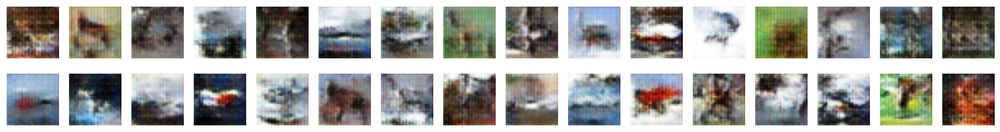

[21/250][150/391]	Loss_D: 1.2930	Loss_G: 0.8110	D(x): 0.0997	D(G(z)): -0.1348 / -0.2073
[21/250][300/391]	Loss_D: 1.3834	Loss_G: 0.7474	D(x): -0.1377	D(G(z)): -0.2045 / -0.0911
[22/250][150/391]	Loss_D: 1.3198	Loss_G: 0.8376	D(x): 0.0813	D(G(z)): -0.1014 / -0.2530
[22/250][300/391]	Loss_D: 1.3953	Loss_G: 0.7646	D(x): -0.0756	D(G(z)): -0.1029 / -0.1213
[23/250][150/391]	Loss_D: 1.4095	Loss_G: 0.8360	D(x): 0.1797	D(G(z)): 0.1537 / -0.2475
[23/250][300/391]	Loss_D: 1.3741	Loss_G: 0.9269	D(x): 0.3395	D(G(z)): 0.2107 / -0.4005
[24/250][150/391]	Loss_D: 1.3126	Loss_G: 0.8241	D(x): 0.0989	D(G(z)): -0.0984 / -0.2307
[24/250][300/391]	Loss_D: 1.4070	Loss_G: 0.7731	D(x): -0.1101	D(G(z)): -0.1199 / -0.1368
[25/250][150/391]	Loss_D: 1.3648	Loss_G: 0.7712	D(x): -0.0147	D(G(z)): -0.0984 / -0.1339
[25/250][300/391]	Loss_D: 1.3446	Loss_G: 0.8431	D(x): -0.0132	D(G(z)): -0.1579 / -0.2582


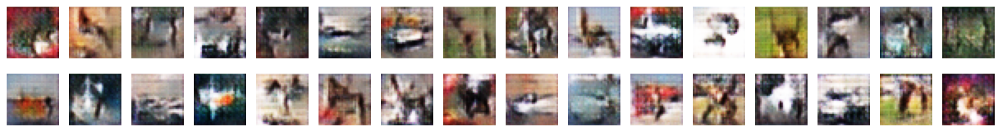

[26/250][150/391]	Loss_D: 1.4022	Loss_G: 0.7486	D(x): 0.0240	D(G(z)): 0.0153 / -0.0923
[26/250][300/391]	Loss_D: 1.3245	Loss_G: 0.8411	D(x): 0.0899	D(G(z)): -0.0885 / -0.2570
[27/250][150/391]	Loss_D: 1.3718	Loss_G: 0.8257	D(x): -0.1230	D(G(z)): -0.2240 / -0.2281
[27/250][300/391]	Loss_D: 1.3550	Loss_G: 0.7986	D(x): -0.0601	D(G(z)): -0.1887 / -0.1754
[28/250][150/391]	Loss_D: 1.3576	Loss_G: 0.7996	D(x): 0.0257	D(G(z)): -0.0894 / -0.1858
[28/250][300/391]	Loss_D: 1.3321	Loss_G: 0.8953	D(x): 0.1321	D(G(z)): -0.0283 / -0.3503
[29/250][150/391]	Loss_D: 1.5237	Loss_G: 0.6681	D(x): -0.5329	D(G(z)): -0.4439 / 0.0785
[29/250][300/391]	Loss_D: 1.3657	Loss_G: 0.7868	D(x): 0.0598	D(G(z)): -0.0292 / -0.1610
[30/250][150/391]	Loss_D: 1.3569	Loss_G: 0.8219	D(x): 0.1969	D(G(z)): 0.0781 / -0.2223
[30/250][300/391]	Loss_D: 1.3296	Loss_G: 0.7966	D(x): -0.0723	D(G(z)): -0.2465 / -0.1787


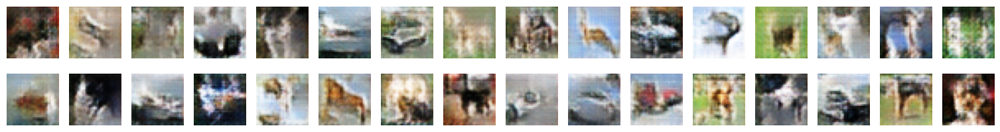

[31/250][150/391]	Loss_D: 1.3178	Loss_G: 0.8690	D(x): 0.0663	D(G(z)): -0.1232 / -0.3053
[31/250][300/391]	Loss_D: 1.4009	Loss_G: 0.8643	D(x): 0.1390	D(G(z)): 0.1050 / -0.2948
[32/250][150/391]	Loss_D: 1.3910	Loss_G: 0.8058	D(x): 0.2004	D(G(z)): 0.1408 / -0.1910
[32/250][300/391]	Loss_D: 1.3358	Loss_G: 0.8467	D(x): 0.0577	D(G(z)): -0.0906 / -0.2663
[33/250][150/391]	Loss_D: 1.4064	Loss_G: 0.8087	D(x): 0.1318	D(G(z)): 0.1040 / -0.2011
[33/250][300/391]	Loss_D: 1.3283	Loss_G: 0.8665	D(x): 0.1891	D(G(z)): 0.0146 / -0.3047
[34/250][150/391]	Loss_D: 1.2820	Loss_G: 0.8472	D(x): 0.0652	D(G(z)): -0.2046 / -0.2700
[34/250][300/391]	Loss_D: 1.3383	Loss_G: 0.8442	D(x): 0.1259	D(G(z)): -0.0283 / -0.2632
[35/250][150/391]	Loss_D: 1.3870	Loss_G: 0.8077	D(x): 0.1202	D(G(z)): 0.0656 / -0.1997
[35/250][300/391]	Loss_D: 1.2976	Loss_G: 0.8887	D(x): 0.2072	D(G(z)): -0.0434 / -0.3359


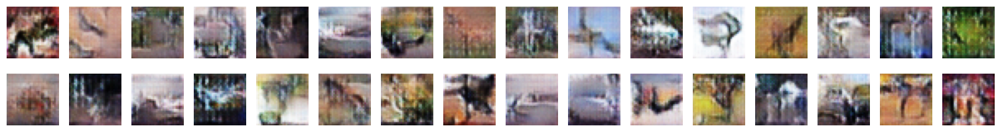

[36/250][150/391]	Loss_D: 1.3048	Loss_G: 0.8691	D(x): 0.2116	D(G(z)): -0.0167 / -0.3040
[36/250][300/391]	Loss_D: 1.3828	Loss_G: 0.8175	D(x): 0.0669	D(G(z)): -0.0011 / -0.2170
[37/250][150/391]	Loss_D: 1.3468	Loss_G: 0.8757	D(x): 0.1530	D(G(z)): 0.0212 / -0.3211
[37/250][300/391]	Loss_D: 1.3068	Loss_G: 0.8559	D(x): 0.1423	D(G(z)): -0.0879 / -0.2739
[38/250][150/391]	Loss_D: 1.3257	Loss_G: 0.8278	D(x): 0.2012	D(G(z)): 0.0106 / -0.2286
[38/250][300/391]	Loss_D: 1.3660	Loss_G: 0.8272	D(x): 0.0200	D(G(z)): -0.0959 / -0.2206
[39/250][150/391]	Loss_D: 1.4333	Loss_G: 0.8751	D(x): 0.0267	D(G(z)): 0.0506 / -0.3082
[39/250][300/391]	Loss_D: 1.4104	Loss_G: 0.7856	D(x): -0.0591	D(G(z)): -0.0794 / -0.1455
[40/250][150/391]	Loss_D: 1.3544	Loss_G: 0.8534	D(x): 0.1525	D(G(z)): 0.0229 / -0.2748
[40/250][300/391]	Loss_D: 1.3188	Loss_G: 0.8565	D(x): -0.0079	D(G(z)): -0.2229 / -0.2763


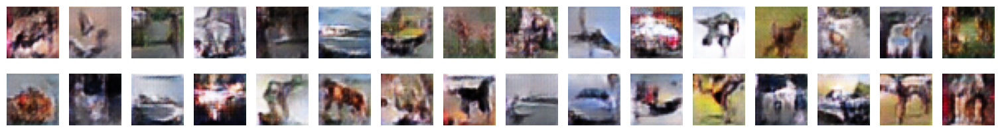

[41/250][150/391]	Loss_D: 1.2742	Loss_G: 0.8219	D(x): -0.1184	D(G(z)): -0.4574 / -0.2202
[41/250][300/391]	Loss_D: 1.3432	Loss_G: 0.8655	D(x): -0.0781	D(G(z)): -0.2245 / -0.3000
[42/250][150/391]	Loss_D: 1.3067	Loss_G: 0.8576	D(x): 0.1544	D(G(z)): -0.0806 / -0.2797
[42/250][300/391]	Loss_D: 1.3520	Loss_G: 0.9014	D(x): 0.2214	D(G(z)): 0.0725 / -0.3558
[43/250][150/391]	Loss_D: 1.3060	Loss_G: 0.9058	D(x): 0.2361	D(G(z)): -0.0031 / -0.3656
[43/250][300/391]	Loss_D: 1.3415	Loss_G: 0.8832	D(x): 0.1566	D(G(z)): -0.0100 / -0.3192
[44/250][150/391]	Loss_D: 1.3710	Loss_G: 0.8247	D(x): -0.1771	D(G(z)): -0.3008 / -0.2257
[44/250][300/391]	Loss_D: 1.2861	Loss_G: 0.8433	D(x): 0.0129	D(G(z)): -0.2744 / -0.2530
[45/250][150/391]	Loss_D: 1.3159	Loss_G: 0.8666	D(x): 0.0773	D(G(z)): -0.1280 / -0.3018
[45/250][300/391]	Loss_D: 1.3170	Loss_G: 0.8453	D(x): 0.0668	D(G(z)): -0.1570 / -0.2607


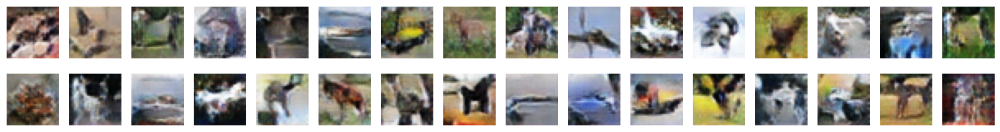

[46/250][150/391]	Loss_D: 1.2721	Loss_G: 0.9603	D(x): 0.2668	D(G(z)): -0.0615 / -0.4546
[46/250][300/391]	Loss_D: 1.3736	Loss_G: 0.8199	D(x): 0.0959	D(G(z)): -0.0044 / -0.2132
[47/250][150/391]	Loss_D: 1.2800	Loss_G: 0.8914	D(x): 0.2660	D(G(z)): -0.0410 / -0.3362
[47/250][300/391]	Loss_D: 1.2947	Loss_G: 0.8585	D(x): 0.1207	D(G(z)): -0.1588 / -0.2763
[48/250][150/391]	Loss_D: 1.2642	Loss_G: 0.9509	D(x): 0.1993	D(G(z)): -0.1430 / -0.4342
[48/250][300/391]	Loss_D: 1.3134	Loss_G: 1.0244	D(x): 0.1198	D(G(z)): -0.1229 / -0.5544
[49/250][150/391]	Loss_D: 1.3738	Loss_G: 0.8118	D(x): -0.0962	D(G(z)): -0.2315 / -0.1803
[49/250][300/391]	Loss_D: 1.3197	Loss_G: 1.0039	D(x): 0.3097	D(G(z)): 0.0688 / -0.5219
[50/250][150/391]	Loss_D: 1.3427	Loss_G: 0.9414	D(x): 0.1806	D(G(z)): -0.0009 / -0.4130
[50/250][300/391]	Loss_D: 1.3380	Loss_G: 1.0366	D(x): 0.2694	D(G(z)): 0.0548 / -0.5683


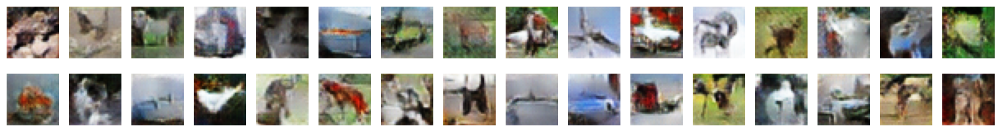

[51/250][150/391]	Loss_D: 1.3015	Loss_G: 0.8729	D(x): -0.0312	D(G(z)): -0.3073 / -0.3019
[51/250][300/391]	Loss_D: 1.3298	Loss_G: 0.9068	D(x): -0.0269	D(G(z)): -0.2508 / -0.3592
[52/250][150/391]	Loss_D: 1.2914	Loss_G: 0.9781	D(x): 0.1309	D(G(z)): -0.1632 / -0.4733
[52/250][300/391]	Loss_D: 1.3975	Loss_G: 0.9698	D(x): 0.3510	D(G(z)): 0.2414 / -0.4616
[53/250][150/391]	Loss_D: 1.2846	Loss_G: 0.9025	D(x): 0.2000	D(G(z)): -0.1277 / -0.3434
[53/250][300/391]	Loss_D: 1.3751	Loss_G: 0.9038	D(x): -0.0482	D(G(z)): -0.1847 / -0.3562
[54/250][150/391]	Loss_D: 1.2525	Loss_G: 0.9097	D(x): 0.0327	D(G(z)): -0.3485 / -0.3725
[54/250][300/391]	Loss_D: 1.4059	Loss_G: 1.0554	D(x): 0.3931	D(G(z)): 0.2806 / -0.5965
[55/250][150/391]	Loss_D: 1.2492	Loss_G: 1.0751	D(x): 0.4227	D(G(z)): -0.0054 / -0.6250
[55/250][300/391]	Loss_D: 1.3371	Loss_G: 1.0089	D(x): 0.4274	D(G(z)): 0.1809 / -0.5210


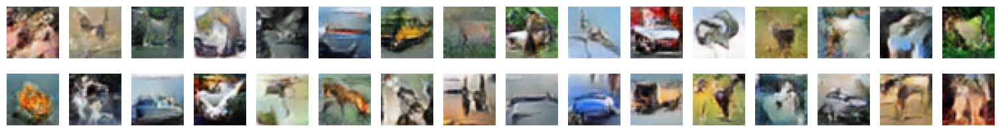

[56/250][150/391]	Loss_D: 1.2135	Loss_G: 0.8278	D(x): -0.0136	D(G(z)): -0.5515 / -0.2125
[56/250][300/391]	Loss_D: 1.3560	Loss_G: 0.7716	D(x): -0.0737	D(G(z)): -0.2413 / -0.1148
[57/250][150/391]	Loss_D: 1.2325	Loss_G: 0.9520	D(x): 0.2416	D(G(z)): -0.2100 / -0.4329
[57/250][300/391]	Loss_D: 1.2046	Loss_G: 0.9997	D(x): 0.3235	D(G(z)): -0.1928 / -0.5013
[58/250][150/391]	Loss_D: 1.2629	Loss_G: 0.8635	D(x): 0.0392	D(G(z)): -0.3602 / -0.2770
[58/250][300/391]	Loss_D: 1.2750	Loss_G: 0.9007	D(x): 0.2997	D(G(z)): -0.0633 / -0.3308
[59/250][150/391]	Loss_D: 1.2972	Loss_G: 1.3115	D(x): 0.5354	D(G(z)): 0.1638 / -0.9692
[59/250][300/391]	Loss_D: 1.2380	Loss_G: 1.0697	D(x): 0.3977	D(G(z)): -0.0601 / -0.6178
[60/250][150/391]	Loss_D: 1.3041	Loss_G: 0.9162	D(x): -0.1136	D(G(z)): -0.4743 / -0.3650
[60/250][300/391]	Loss_D: 1.2505	Loss_G: 1.0824	D(x): 0.2937	D(G(z)): -0.1171 / -0.6361


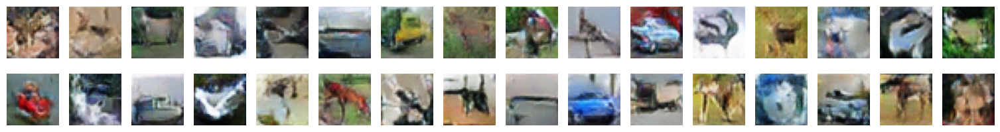

[61/250][150/391]	Loss_D: 1.2614	Loss_G: 1.1676	D(x): 0.4532	D(G(z)): 0.0212 / -0.7546
[61/250][300/391]	Loss_D: 1.2374	Loss_G: 0.9931	D(x): 0.3851	D(G(z)): -0.0724 / -0.4948
[62/250][150/391]	Loss_D: 1.1244	Loss_G: 1.1121	D(x): 0.4211	D(G(z)): -0.2853 / -0.6749
[62/250][300/391]	Loss_D: 1.3313	Loss_G: 1.1457	D(x): 0.7387	D(G(z)): 0.3290 / -0.7292
[63/250][150/391]	Loss_D: 1.1639	Loss_G: 1.2754	D(x): 0.3889	D(G(z)): -0.2767 / -0.9058
[63/250][300/391]	Loss_D: 1.2780	Loss_G: 1.3497	D(x): 0.8741	D(G(z)): 0.3169 / -1.0200
[64/250][150/391]	Loss_D: 1.2530	Loss_G: 0.9339	D(x): -0.0329	D(G(z)): -0.5133 / -0.3822
[64/250][300/391]	Loss_D: 1.1911	Loss_G: 1.1538	D(x): 0.3453	D(G(z)): -0.2223 / -0.7352
[65/250][150/391]	Loss_D: 1.1593	Loss_G: 1.0960	D(x): 0.4411	D(G(z)): -0.2080 / -0.6516
[65/250][300/391]	Loss_D: 1.2439	Loss_G: 0.9739	D(x): 0.1710	D(G(z)): -0.2837 / -0.4516


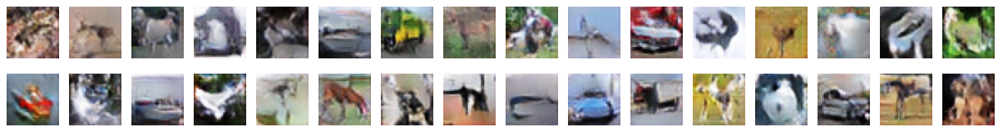

[66/250][150/391]	Loss_D: 1.2312	Loss_G: 1.2815	D(x): 0.8562	D(G(z)): 0.2084 / -0.9140
[66/250][300/391]	Loss_D: 1.3247	Loss_G: 1.3616	D(x): 0.4628	D(G(z)): 0.1158 / -1.0294
[67/250][150/391]	Loss_D: 1.1897	Loss_G: 1.1808	D(x): 0.2964	D(G(z)): -0.2851 / -0.7816
[67/250][300/391]	Loss_D: 1.2214	Loss_G: 1.1765	D(x): 0.3899	D(G(z)): -0.1433 / -0.7623
[68/250][150/391]	Loss_D: 1.2948	Loss_G: 1.4377	D(x): 1.0434	D(G(z)): 0.3986 / -1.1223
[68/250][300/391]	Loss_D: 1.3019	Loss_G: 1.2161	D(x): 0.5077	D(G(z)): 0.0820 / -0.8219
[69/250][150/391]	Loss_D: 1.0923	Loss_G: 1.1706	D(x): 0.3545	D(G(z)): -0.4497 / -0.7621
[69/250][300/391]	Loss_D: 1.1380	Loss_G: 1.0361	D(x): 0.1830	D(G(z)): -0.5479 / -0.5531
[70/250][150/391]	Loss_D: 1.0915	Loss_G: 1.1304	D(x): 0.4835	D(G(z)): -0.3336 / -0.7075
[70/250][300/391]	Loss_D: 1.2885	Loss_G: 0.7312	D(x): -0.4071	D(G(z)): -1.1323 / 0.0024


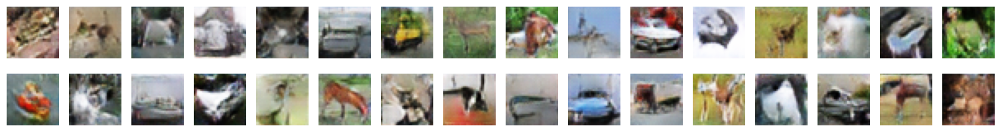

[71/250][150/391]	Loss_D: 1.1502	Loss_G: 1.0297	D(x): 0.2102	D(G(z)): -0.5548 / -0.5282
[71/250][300/391]	Loss_D: 1.1219	Loss_G: 1.3978	D(x): 1.0575	D(G(z)): 0.0860 / -1.0718
[72/250][150/391]	Loss_D: 1.1664	Loss_G: 1.1730	D(x): 0.2118	D(G(z)): -0.5056 / -0.7367
[72/250][300/391]	Loss_D: 1.2260	Loss_G: 1.1137	D(x): 0.3211	D(G(z)): -0.2112 / -0.6692
[73/250][150/391]	Loss_D: 1.0807	Loss_G: 1.2233	D(x): 0.7169	D(G(z)): -0.1916 / -0.8257
[73/250][300/391]	Loss_D: 1.1089	Loss_G: 1.2782	D(x): 0.6147	D(G(z)): -0.2502 / -0.8848
[74/250][150/391]	Loss_D: 1.1882	Loss_G: 1.4024	D(x): 0.5841	D(G(z)): -0.0879 / -1.0821
[74/250][300/391]	Loss_D: 1.1630	Loss_G: 0.9365	D(x): -0.1029	D(G(z)): -0.9297 / -0.3770
[75/250][150/391]	Loss_D: 1.0881	Loss_G: 1.5318	D(x): 1.0679	D(G(z)): -0.0255 / -1.2528
[75/250][300/391]	Loss_D: 1.1819	Loss_G: 1.6501	D(x): 1.1002	D(G(z)): 0.2289 / -1.3989


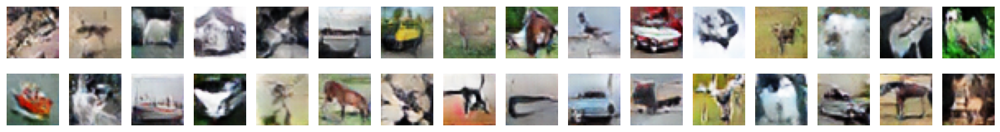

[76/250][150/391]	Loss_D: 1.1416	Loss_G: 1.5852	D(x): 1.0660	D(G(z)): 0.1009 / -1.3233
[76/250][300/391]	Loss_D: 1.1159	Loss_G: 1.1525	D(x): 0.3220	D(G(z)): -0.5021 / -0.7246
[77/250][150/391]	Loss_D: 1.0180	Loss_G: 1.2793	D(x): 0.3615	D(G(z)): -0.7768 / -0.8924
[77/250][300/391]	Loss_D: 1.0589	Loss_G: 1.4507	D(x): 1.1093	D(G(z)): -0.0392 / -1.1424
[78/250][150/391]	Loss_D: 1.0384	Loss_G: 1.2973	D(x): 0.4711	D(G(z)): -0.5320 / -0.9372
[78/250][300/391]	Loss_D: 1.0994	Loss_G: 1.2244	D(x): 0.2780	D(G(z)): -0.5656 / -0.8294
[79/250][150/391]	Loss_D: 1.0647	Loss_G: 1.3396	D(x): 0.7285	D(G(z)): -0.2806 / -1.0040
[79/250][300/391]	Loss_D: 1.0861	Loss_G: 1.0547	D(x): 0.3174	D(G(z)): -0.6495 / -0.5608
[80/250][150/391]	Loss_D: 0.9855	Loss_G: 1.2539	D(x): 0.5964	D(G(z)): -0.5938 / -0.8676
[80/250][300/391]	Loss_D: 0.9949	Loss_G: 1.2605	D(x): 1.0518	D(G(z)): -0.2429 / -0.8686


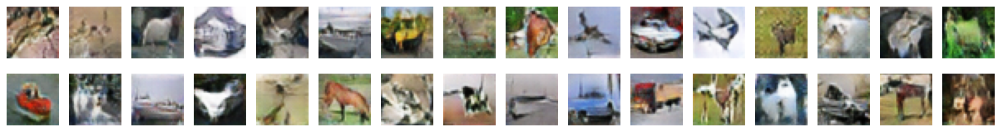

[81/250][150/391]	Loss_D: 0.8386	Loss_G: 1.4428	D(x): 0.9555	D(G(z)): -0.6525 / -1.1208
[81/250][300/391]	Loss_D: 1.0634	Loss_G: 1.5499	D(x): 0.7470	D(G(z)): -0.2780 / -1.2648
[82/250][150/391]	Loss_D: 1.1606	Loss_G: 1.5414	D(x): 0.6714	D(G(z)): -0.0969 / -1.2600
[82/250][300/391]	Loss_D: 0.7537	Loss_G: 2.4837	D(x): 1.7996	D(G(z)): -0.4161 / -2.3767
[83/250][150/391]	Loss_D: 0.9998	Loss_G: 1.5774	D(x): 0.9875	D(G(z)): -0.2332 / -1.3033
[83/250][300/391]	Loss_D: 0.9373	Loss_G: 2.0219	D(x): 1.0966	D(G(z)): -0.3268 / -1.8530
[84/250][150/391]	Loss_D: 1.0098	Loss_G: 1.8475	D(x): 1.3732	D(G(z)): -0.0108 / -1.6440
[84/250][300/391]	Loss_D: 0.9305	Loss_G: 1.4659	D(x): 0.8643	D(G(z)): -0.5756 / -1.1482
[85/250][150/391]	Loss_D: 0.9936	Loss_G: 1.6281	D(x): 0.4994	D(G(z)): -0.6798 / -1.3795
[85/250][300/391]	Loss_D: 1.0456	Loss_G: 1.7526	D(x): 0.7390	D(G(z)): -0.3518 / -1.5201


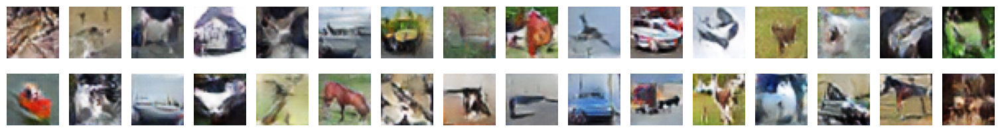

[86/250][150/391]	Loss_D: 0.9114	Loss_G: 1.5909	D(x): 0.6535	D(G(z)): -0.7659 / -1.3132
[86/250][300/391]	Loss_D: 1.0369	Loss_G: 1.2294	D(x): 0.2242	D(G(z)): -0.9357 / -0.8117
[87/250][150/391]	Loss_D: 1.0577	Loss_G: 1.1112	D(x): 0.2416	D(G(z)): -0.8657 / -0.6411
[87/250][300/391]	Loss_D: 0.8813	Loss_G: 1.4843	D(x): 0.8762	D(G(z)): -0.6874 / -1.1733
[88/250][150/391]	Loss_D: 1.0070	Loss_G: 1.6960	D(x): 1.1731	D(G(z)): -0.1810 / -1.4472
[88/250][300/391]	Loss_D: 0.9775	Loss_G: 1.2528	D(x): 0.4040	D(G(z)): -0.9972 / -0.8534
[89/250][150/391]	Loss_D: 0.9556	Loss_G: 1.3101	D(x): 0.5493	D(G(z)): -0.7648 / -0.9218
[89/250][300/391]	Loss_D: 0.9466	Loss_G: 1.6678	D(x): 0.6915	D(G(z)): -0.6964 / -1.4050
[90/250][150/391]	Loss_D: 1.0169	Loss_G: 1.4491	D(x): 0.5251	D(G(z)): -0.6868 / -1.1180
[90/250][300/391]	Loss_D: 0.8727	Loss_G: 1.6117	D(x): 0.9191	D(G(z)): -0.6764 / -1.3329


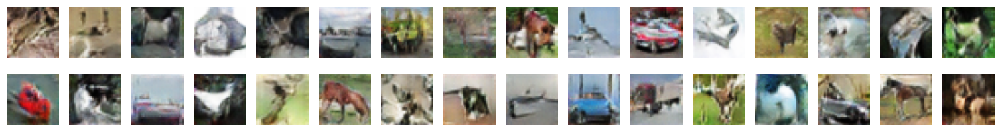

[91/250][150/391]	Loss_D: 1.0661	Loss_G: 1.6401	D(x): 0.7185	D(G(z)): -0.4182 / -1.3693
[91/250][300/391]	Loss_D: 0.9233	Loss_G: 1.4540	D(x): 0.6807	D(G(z)): -0.8048 / -1.1209
[92/250][150/391]	Loss_D: 1.0566	Loss_G: 1.2027	D(x): 0.1972	D(G(z)): -0.9744 / -0.7719
[92/250][300/391]	Loss_D: 0.9513	Loss_G: 1.2899	D(x): 0.4416	D(G(z)): -1.0076 / -0.8926
[93/250][150/391]	Loss_D: 0.9344	Loss_G: 1.5781	D(x): 1.0349	D(G(z)): -0.4610 / -1.2906
[93/250][300/391]	Loss_D: 0.8405	Loss_G: 1.6781	D(x): 0.8971	D(G(z)): -0.8169 / -1.4269
[94/250][150/391]	Loss_D: 0.8629	Loss_G: 1.3340	D(x): 0.3456	D(G(z)): -1.5869 / -0.9385
[94/250][300/391]	Loss_D: 0.9275	Loss_G: 1.6558	D(x): 0.7412	D(G(z)): -0.7231 / -1.3861
[95/250][150/391]	Loss_D: 0.8278	Loss_G: 1.6579	D(x): 0.8701	D(G(z)): -0.9398 / -1.3951
[95/250][300/391]	Loss_D: 0.7091	Loss_G: 1.9541	D(x): 1.1439	D(G(z)): -0.9710 / -1.7617


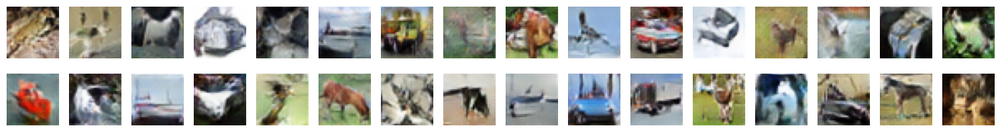

[96/250][150/391]	Loss_D: 0.9353	Loss_G: 1.2910	D(x): 0.3459	D(G(z)): -1.1878 / -0.8738
[96/250][300/391]	Loss_D: 0.9505	Loss_G: 1.9802	D(x): 1.4661	D(G(z)): -0.2087 / -1.7868
[97/250][150/391]	Loss_D: 0.7758	Loss_G: 1.6780	D(x): 1.1310	D(G(z)): -0.8885 / -1.4106
[97/250][300/391]	Loss_D: 0.7917	Loss_G: 1.3763	D(x): 0.6922	D(G(z)): -1.2605 / -1.0111
[98/250][150/391]	Loss_D: 0.8894	Loss_G: 1.3114	D(x): 0.2934	D(G(z)): -1.5460 / -0.9100
[98/250][300/391]	Loss_D: 0.8573	Loss_G: 1.7258	D(x): 1.1340	D(G(z)): -0.6105 / -1.4856
[99/250][150/391]	Loss_D: 0.7977	Loss_G: 1.4720	D(x): 0.6789	D(G(z)): -1.3171 / -1.1519
[99/250][300/391]	Loss_D: 0.8288	Loss_G: 1.7590	D(x): 0.7557	D(G(z)): -1.0890 / -1.5145
[100/250][150/391]	Loss_D: 0.8717	Loss_G: 1.4541	D(x): 0.5091	D(G(z)): -1.3415 / -1.0871
[100/250][300/391]	Loss_D: 0.9379	Loss_G: 1.8576	D(x): 1.1648	D(G(z)): -0.4264 / -1.6450


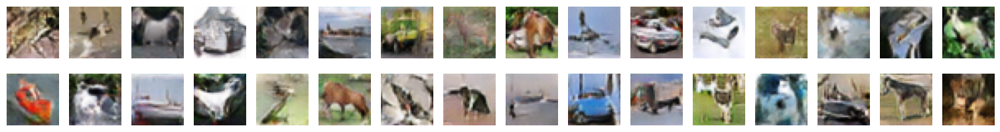

[101/250][150/391]	Loss_D: 0.8993	Loss_G: 1.3503	D(x): 0.8288	D(G(z)): -0.7604 / -0.9682
[101/250][300/391]	Loss_D: 0.7721	Loss_G: 1.7067	D(x): 1.0000	D(G(z)): -1.0451 / -1.4360
[102/250][150/391]	Loss_D: 0.8386	Loss_G: 2.1928	D(x): 1.1884	D(G(z)): -0.6805 / -2.0371
[102/250][300/391]	Loss_D: 0.7466	Loss_G: 1.7689	D(x): 0.9062	D(G(z)): -1.1156 / -1.5316
[103/250][150/391]	Loss_D: 0.8008	Loss_G: 2.1373	D(x): 1.3046	D(G(z)): -0.7563 / -1.9668
[103/250][300/391]	Loss_D: 0.7999	Loss_G: 1.7905	D(x): 1.0665	D(G(z)): -0.9533 / -1.5421
[104/250][150/391]	Loss_D: 0.8392	Loss_G: 1.9718	D(x): 1.0854	D(G(z)): -0.9497 / -1.7545
[104/250][300/391]	Loss_D: 0.7935	Loss_G: 1.5410	D(x): 0.7955	D(G(z)): -1.1594 / -1.2329
[105/250][150/391]	Loss_D: 0.8780	Loss_G: 1.8828	D(x): 1.0711	D(G(z)): -0.7221 / -1.6589
[105/250][300/391]	Loss_D: 0.8391	Loss_G: 2.3163	D(x): 1.3386	D(G(z)): -0.6065 / -2.1705


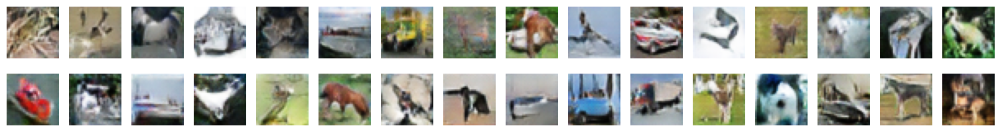

[106/250][150/391]	Loss_D: 0.9421	Loss_G: 1.3333	D(x): 0.5107	D(G(z)): -1.0234 / -0.9565
[106/250][300/391]	Loss_D: 0.7900	Loss_G: 1.9898	D(x): 0.9525	D(G(z)): -1.0817 / -1.7943
[107/250][150/391]	Loss_D: 0.6743	Loss_G: 1.8936	D(x): 1.3493	D(G(z)): -1.1117 / -1.6735
[107/250][300/391]	Loss_D: 0.8654	Loss_G: 1.5275	D(x): 0.9161	D(G(z)): -0.8629 / -1.2049
[108/250][150/391]	Loss_D: 0.7959	Loss_G: 2.4221	D(x): 1.8641	D(G(z)): -0.5193 / -2.2929
[108/250][300/391]	Loss_D: 0.7377	Loss_G: 1.8900	D(x): 1.1756	D(G(z)): -1.1641 / -1.6733
[109/250][150/391]	Loss_D: 0.8301	Loss_G: 1.5954	D(x): 0.4960	D(G(z)): -1.7793 / -1.2578
[109/250][300/391]	Loss_D: 0.7009	Loss_G: 1.9780	D(x): 0.6908	D(G(z)): -1.8944 / -1.7648
[110/250][150/391]	Loss_D: 0.8028	Loss_G: 1.5027	D(x): 0.2964	D(G(z)): -2.2175 / -1.1636
[110/250][300/391]	Loss_D: 0.7768	Loss_G: 1.8475	D(x): 0.7478	D(G(z)): -1.4443 / -1.6094


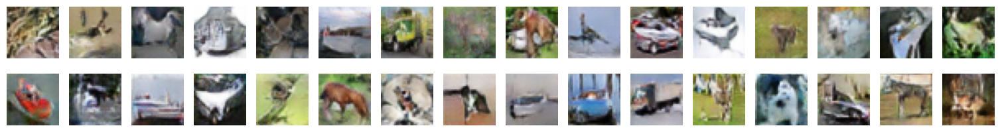

[111/250][150/391]	Loss_D: 0.7287	Loss_G: 2.3034	D(x): 1.3316	D(G(z)): -1.1395 / -2.1361
[111/250][300/391]	Loss_D: 0.6595	Loss_G: 2.1539	D(x): 1.3714	D(G(z)): -1.2972 / -1.9719
[112/250][150/391]	Loss_D: 0.7796	Loss_G: 1.7615	D(x): 0.6653	D(G(z)): -1.6121 / -1.4999
[112/250][300/391]	Loss_D: 0.5878	Loss_G: 2.2330	D(x): 1.2387	D(G(z)): -1.6693 / -2.0630
[113/250][150/391]	Loss_D: 0.6369	Loss_G: 2.1660	D(x): 1.3586	D(G(z)): -1.3998 / -1.9825
[113/250][300/391]	Loss_D: 0.7321	Loss_G: 1.4395	D(x): 1.0671	D(G(z)): -1.2901 / -1.0851
[114/250][150/391]	Loss_D: 0.7125	Loss_G: 1.8932	D(x): 0.6003	D(G(z)): -2.1923 / -1.6408
[114/250][300/391]	Loss_D: 0.8365	Loss_G: 1.0354	D(x): 0.1350	D(G(z)): -2.5596 / -0.3950
[115/250][150/391]	Loss_D: 0.5623	Loss_G: 2.1669	D(x): 1.8021	D(G(z)): -1.2888 / -1.9992
[115/250][300/391]	Loss_D: 0.7838	Loss_G: 2.5009	D(x): 1.5157	D(G(z)): -0.9251 / -2.3692


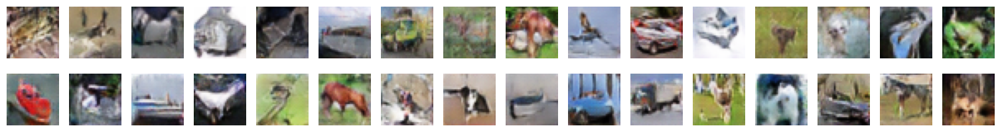

[116/250][150/391]	Loss_D: 0.6217	Loss_G: 2.0778	D(x): 1.1857	D(G(z)): -1.6271 / -1.8895
[116/250][300/391]	Loss_D: 0.7124	Loss_G: 1.9872	D(x): 1.2894	D(G(z)): -1.1831 / -1.7926
[117/250][150/391]	Loss_D: 0.7223	Loss_G: 2.0787	D(x): 1.1522	D(G(z)): -1.2106 / -1.8859
[117/250][300/391]	Loss_D: 0.6026	Loss_G: 2.6611	D(x): 1.4109	D(G(z)): -1.5517 / -2.5506
[118/250][150/391]	Loss_D: 0.5597	Loss_G: 2.1811	D(x): 1.5282	D(G(z)): -1.4397 / -2.0171
[118/250][300/391]	Loss_D: 0.6216	Loss_G: 1.7333	D(x): 0.8369	D(G(z)): -2.4021 / -1.4336
[119/250][150/391]	Loss_D: 0.6663	Loss_G: 2.1975	D(x): 1.1965	D(G(z)): -1.3106 / -2.0332
[119/250][300/391]	Loss_D: 0.6356	Loss_G: 2.8431	D(x): 1.7938	D(G(z)): -1.0183 / -2.7583
[120/250][150/391]	Loss_D: 0.7418	Loss_G: 1.6360	D(x): 0.6312	D(G(z)): -2.0642 / -1.2955
[120/250][300/391]	Loss_D: 0.5274	Loss_G: 1.9099	D(x): 1.6444	D(G(z)): -1.6262 / -1.6781


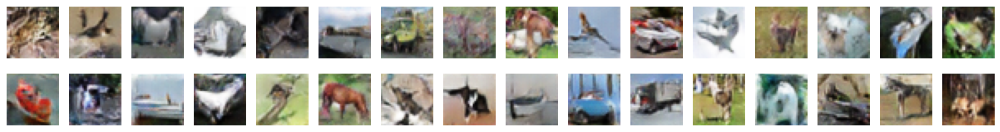

[121/250][150/391]	Loss_D: 0.6492	Loss_G: 2.8787	D(x): 2.1679	D(G(z)): -0.8296 / -2.7956
[121/250][300/391]	Loss_D: 0.7085	Loss_G: 2.3842	D(x): 1.1374	D(G(z)): -1.4712 / -2.2283
[122/250][150/391]	Loss_D: 0.6350	Loss_G: 2.1733	D(x): 1.2239	D(G(z)): -1.5733 / -1.9818
[122/250][300/391]	Loss_D: 0.5856	Loss_G: 1.9323	D(x): 1.4341	D(G(z)): -1.6761 / -1.6887
[123/250][150/391]	Loss_D: 0.6516	Loss_G: 2.1208	D(x): 1.3396	D(G(z)): -1.5316 / -1.9140
[123/250][300/391]	Loss_D: 0.5174	Loss_G: 2.2192	D(x): 1.6602	D(G(z)): -1.8600 / -2.0284
[124/250][150/391]	Loss_D: 0.6243	Loss_G: 2.3398	D(x): 1.5756	D(G(z)): -1.3335 / -2.1965
[124/250][300/391]	Loss_D: 0.6064	Loss_G: 2.5651	D(x): 1.4485	D(G(z)): -1.7465 / -2.4253
[125/250][150/391]	Loss_D: 0.6626	Loss_G: 2.9932	D(x): 2.0949	D(G(z)): -0.8600 / -2.9195
[125/250][300/391]	Loss_D: 0.7202	Loss_G: 1.5904	D(x): 0.5520	D(G(z)): -2.3941 / -1.2556


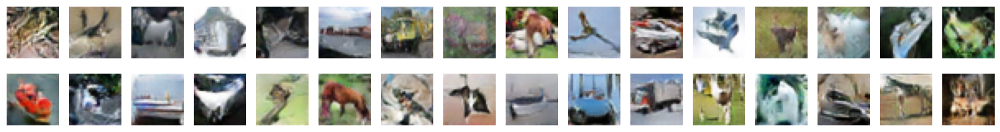

[126/250][150/391]	Loss_D: 0.4928	Loss_G: 2.2905	D(x): 1.4864	D(G(z)): -2.0401 / -2.1176
[126/250][300/391]	Loss_D: 0.5572	Loss_G: 2.2723	D(x): 1.2499	D(G(z)): -2.1735 / -2.0901
[127/250][150/391]	Loss_D: 0.4673	Loss_G: 2.7434	D(x): 2.1452	D(G(z)): -1.4774 / -2.6482
[127/250][300/391]	Loss_D: 0.6310	Loss_G: 2.6749	D(x): 1.9418	D(G(z)): -1.1665 / -2.5524
[128/250][150/391]	Loss_D: 0.5902	Loss_G: 2.9328	D(x): 1.9693	D(G(z)): -1.3479 / -2.8354
[128/250][300/391]	Loss_D: 0.5222	Loss_G: 2.8118	D(x): 1.9025	D(G(z)): -1.6390 / -2.7076
[129/250][150/391]	Loss_D: 0.5420	Loss_G: 2.7082	D(x): 1.7043	D(G(z)): -1.6172 / -2.5945
[129/250][300/391]	Loss_D: 0.3792	Loss_G: 2.2827	D(x): 1.7724	D(G(z)): -2.4138 / -2.1207
[130/250][150/391]	Loss_D: 0.6672	Loss_G: 1.9191	D(x): 1.0101	D(G(z)): -2.0428 / -1.6441
[130/250][300/391]	Loss_D: 0.6591	Loss_G: 2.6135	D(x): 2.0657	D(G(z)): -1.1115 / -2.4853


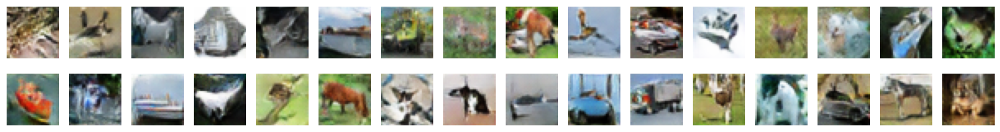

[131/250][150/391]	Loss_D: 0.5579	Loss_G: 2.3868	D(x): 1.1260	D(G(z)): -2.5123 / -2.2245
[131/250][300/391]	Loss_D: 0.5948	Loss_G: 1.8869	D(x): 1.0795	D(G(z)): -2.1095 / -1.6272
[132/250][150/391]	Loss_D: 0.7302	Loss_G: 1.8844	D(x): 0.6434	D(G(z)): -2.1068 / -1.6446
[132/250][300/391]	Loss_D: 0.4306	Loss_G: 2.2755	D(x): 1.6893	D(G(z)): -2.3849 / -2.0971
[133/250][150/391]	Loss_D: 0.4773	Loss_G: 2.5474	D(x): 1.6912	D(G(z)): -2.0583 / -2.4230
[133/250][300/391]	Loss_D: 0.4956	Loss_G: 2.5012	D(x): 1.3714	D(G(z)): -2.6851 / -2.3163
[134/250][150/391]	Loss_D: 0.5405	Loss_G: 2.6812	D(x): 1.7630	D(G(z)): -1.7006 / -2.5665
[134/250][300/391]	Loss_D: 0.5285	Loss_G: 2.2117	D(x): 1.2429	D(G(z)): -2.3338 / -2.0014
[135/250][150/391]	Loss_D: 0.4145	Loss_G: 2.9060	D(x): 1.6107	D(G(z)): -2.7649 / -2.7912
[135/250][300/391]	Loss_D: 0.3912	Loss_G: 2.7087	D(x): 1.8882	D(G(z)): -2.2282 / -2.5993


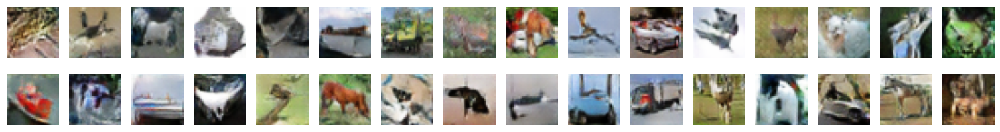

[136/250][150/391]	Loss_D: 0.6414	Loss_G: 3.8943	D(x): 3.7856	D(G(z)): -0.6365 / -3.8600
[136/250][300/391]	Loss_D: 0.5718	Loss_G: 1.9198	D(x): 1.1724	D(G(z)): -2.1406 / -1.6643
[137/250][150/391]	Loss_D: 0.5451	Loss_G: 2.5733	D(x): 1.2095	D(G(z)): -2.4203 / -2.4301
[137/250][300/391]	Loss_D: 0.4600	Loss_G: 2.3771	D(x): 1.7451	D(G(z)): -2.1022 / -2.2093
[138/250][150/391]	Loss_D: 0.5041	Loss_G: 2.9799	D(x): 1.9694	D(G(z)): -1.7064 / -2.9006
[138/250][300/391]	Loss_D: 0.4606	Loss_G: 3.1295	D(x): 2.0174	D(G(z)): -1.9109 / -3.0593
[139/250][150/391]	Loss_D: 0.4544	Loss_G: 2.7506	D(x): 1.3881	D(G(z)): -3.1492 / -2.6152
[139/250][300/391]	Loss_D: 0.5568	Loss_G: 2.1532	D(x): 0.9648	D(G(z)): -3.0990 / -1.9152
[140/250][150/391]	Loss_D: 0.5469	Loss_G: 2.5027	D(x): 1.8102	D(G(z)): -1.8343 / -2.3629
[140/250][300/391]	Loss_D: 0.6014	Loss_G: 3.5992	D(x): 2.4195	D(G(z)): -1.1088 / -3.5559


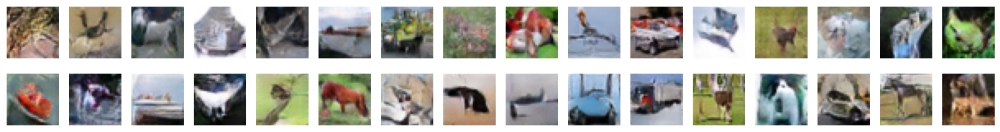

[141/250][150/391]	Loss_D: 0.5943	Loss_G: 1.9529	D(x): 0.8453	D(G(z)): -2.7562 / -1.6673
[141/250][300/391]	Loss_D: 0.4804	Loss_G: 3.1572	D(x): 2.0710	D(G(z)): -1.9531 / -3.0825
[142/250][150/391]	Loss_D: 0.4077	Loss_G: 3.3911	D(x): 2.4431	D(G(z)): -1.8530 / -3.3289
[142/250][300/391]	Loss_D: 0.5479	Loss_G: 1.9713	D(x): 1.2434	D(G(z)): -2.3375 / -1.7059
[143/250][150/391]	Loss_D: 0.4303	Loss_G: 3.9617	D(x): 2.8643	D(G(z)): -1.7460 / -3.9237
[143/250][300/391]	Loss_D: 0.4616	Loss_G: 2.8785	D(x): 1.7527	D(G(z)): -2.4164 / -2.7704
[144/250][150/391]	Loss_D: 0.4484	Loss_G: 2.6617	D(x): 1.8328	D(G(z)): -2.1685 / -2.5394
[144/250][300/391]	Loss_D: 0.4883	Loss_G: 2.3637	D(x): 1.4278	D(G(z)): -2.6461 / -2.1646
[145/250][150/391]	Loss_D: 0.5296	Loss_G: 2.7216	D(x): 1.3863	D(G(z)): -2.5025 / -2.5779
[145/250][300/391]	Loss_D: 0.4142	Loss_G: 2.2104	D(x): 1.4732	D(G(z)): -2.9428 / -1.9942


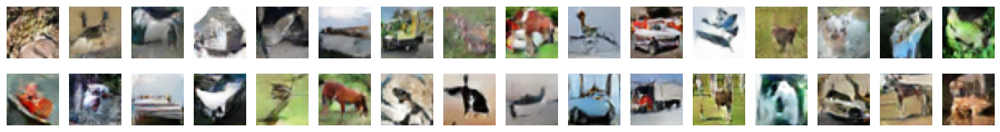

[146/250][150/391]	Loss_D: 0.4094	Loss_G: 3.9935	D(x): 3.0602	D(G(z)): -1.7199 / -3.9591
[146/250][300/391]	Loss_D: 0.4217	Loss_G: 2.9651	D(x): 2.2386	D(G(z)): -2.0758 / -2.8669
[147/250][150/391]	Loss_D: 0.3289	Loss_G: 2.8290	D(x): 2.0977	D(G(z)): -2.7325 / -2.7198
[147/250][300/391]	Loss_D: 0.5103	Loss_G: 2.4791	D(x): 1.1055	D(G(z)): -3.2628 / -2.3021
[148/250][150/391]	Loss_D: 0.3812	Loss_G: 2.9084	D(x): 1.8784	D(G(z)): -2.5873 / -2.8033
[148/250][300/391]	Loss_D: 0.3280	Loss_G: 3.3140	D(x): 2.2595	D(G(z)): -2.7986 / -3.2393
[149/250][150/391]	Loss_D: 0.4912	Loss_G: 1.9683	D(x): 1.3574	D(G(z)): -2.7128 / -1.7170
[149/250][300/391]	Loss_D: 0.4732	Loss_G: 2.9357	D(x): 1.8730	D(G(z)): -2.4123 / -2.8354
[150/250][150/391]	Loss_D: 0.5896	Loss_G: 1.9883	D(x): 1.0879	D(G(z)): -2.9856 / -1.6753
[150/250][300/391]	Loss_D: 0.3218	Loss_G: 3.5167	D(x): 2.5033	D(G(z)): -2.4878 / -3.4615


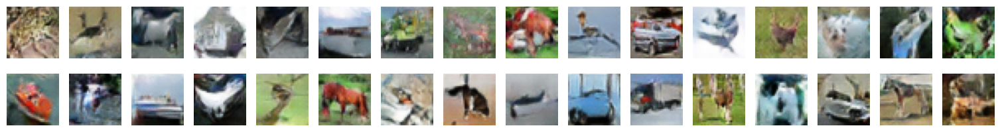

[151/250][150/391]	Loss_D: 0.4305	Loss_G: 3.3222	D(x): 2.1672	D(G(z)): -2.2747 / -3.2447
[151/250][300/391]	Loss_D: 0.3984	Loss_G: 3.5732	D(x): 2.6873	D(G(z)): -2.0338 / -3.5109
[152/250][150/391]	Loss_D: 0.4128	Loss_G: 4.0738	D(x): 3.6447	D(G(z)): -1.5041 / -4.0428
[152/250][300/391]	Loss_D: 0.4082	Loss_G: 2.7193	D(x): 1.6206	D(G(z)): -3.0152 / -2.5792
[153/250][150/391]	Loss_D: 0.3199	Loss_G: 2.6736	D(x): 2.1424	D(G(z)): -2.8049 / -2.5425
[153/250][300/391]	Loss_D: 0.3711	Loss_G: 2.8886	D(x): 2.0317	D(G(z)): -2.8252 / -2.7709
[154/250][150/391]	Loss_D: 0.5422	Loss_G: 4.3410	D(x): 3.1364	D(G(z)): -1.5864 / -4.3150
[154/250][300/391]	Loss_D: 0.2974	Loss_G: 3.6025	D(x): 2.5611	D(G(z)): -2.7355 / -3.5505
[155/250][150/391]	Loss_D: 0.5150	Loss_G: 1.9652	D(x): 1.1697	D(G(z)): -3.6180 / -1.6601
[155/250][300/391]	Loss_D: 0.2112	Loss_G: 4.2051	D(x): 3.5662	D(G(z)): -2.6165 / -4.1792


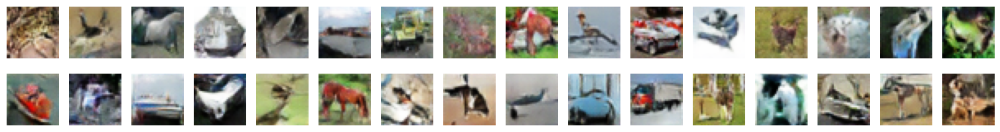

[156/250][150/391]	Loss_D: 0.3635	Loss_G: 3.0609	D(x): 2.1883	D(G(z)): -2.6094 / -2.9600
[156/250][300/391]	Loss_D: 0.6450	Loss_G: 4.5601	D(x): 2.7465	D(G(z)): -1.2646 / -4.5372
[157/250][150/391]	Loss_D: 0.3766	Loss_G: 2.9903	D(x): 1.6437	D(G(z)): -3.4980 / -2.8694
[157/250][300/391]	Loss_D: 0.3610	Loss_G: 3.2001	D(x): 2.0837	D(G(z)): -2.6971 / -3.1148
[158/250][150/391]	Loss_D: 0.3237	Loss_G: 3.4426	D(x): 2.3572	D(G(z)): -2.8815 / -3.3694
[158/250][300/391]	Loss_D: 0.4579	Loss_G: 2.5873	D(x): 1.7056	D(G(z)): -3.0015 / -2.4202
[159/250][150/391]	Loss_D: 0.4415	Loss_G: 2.2794	D(x): 1.2913	D(G(z)): -3.6693 / -2.0196
[159/250][300/391]	Loss_D: 0.4709	Loss_G: 3.9715	D(x): 3.3328	D(G(z)): -1.5287 / -3.9304
[160/250][150/391]	Loss_D: 0.2620	Loss_G: 3.5899	D(x): 2.8564	D(G(z)): -2.7039 / -3.5346
[160/250][300/391]	Loss_D: 0.5328	Loss_G: 1.7593	D(x): 1.1794	D(G(z)): -3.4259 / -1.3745


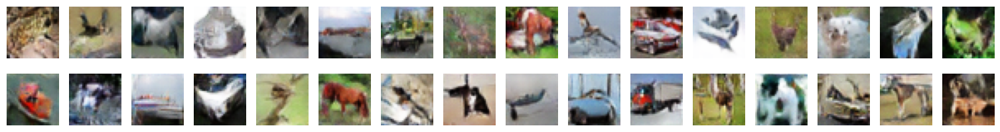

[161/250][150/391]	Loss_D: 0.3031	Loss_G: 2.9760	D(x): 2.3694	D(G(z)): -2.8442 / -2.8771
[161/250][300/391]	Loss_D: 0.2943	Loss_G: 3.6455	D(x): 2.8082	D(G(z)): -2.7323 / -3.5866
[162/250][150/391]	Loss_D: 0.3287	Loss_G: 2.8413	D(x): 2.1745	D(G(z)): -2.9572 / -2.7228
[162/250][300/391]	Loss_D: 0.2656	Loss_G: 2.8425	D(x): 2.3714	D(G(z)): -3.2890 / -2.7106
[163/250][150/391]	Loss_D: 0.3348	Loss_G: 3.4125	D(x): 2.5858	D(G(z)): -2.3800 / -3.3372
[163/250][300/391]	Loss_D: 0.3636	Loss_G: 3.1701	D(x): 1.9079	D(G(z)): -3.3749 / -3.0688
[164/250][150/391]	Loss_D: 0.2352	Loss_G: 3.6552	D(x): 2.9543	D(G(z)): -3.0856 / -3.5918
[164/250][300/391]	Loss_D: 0.2950	Loss_G: 3.4923	D(x): 2.4649	D(G(z)): -3.1313 / -3.3993
[165/250][150/391]	Loss_D: 0.2327	Loss_G: 3.4398	D(x): 2.8370	D(G(z)): -3.0791 / -3.3677
[165/250][300/391]	Loss_D: 0.4391	Loss_G: 4.1293	D(x): 3.4763	D(G(z)): -1.8786 / -4.0931


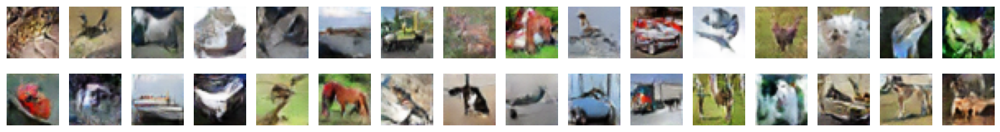

[166/250][150/391]	Loss_D: 0.2718	Loss_G: 3.2420	D(x): 2.6003	D(G(z)): -2.9528 / -3.1601
[166/250][300/391]	Loss_D: 0.3895	Loss_G: 2.3040	D(x): 1.5752	D(G(z)): -3.7420 / -2.0526
[167/250][150/391]	Loss_D: 0.2189	Loss_G: 3.2544	D(x): 2.6701	D(G(z)): -3.2710 / -3.1756
[167/250][300/391]	Loss_D: 0.3340	Loss_G: 4.1351	D(x): 3.2228	D(G(z)): -2.4207 / -4.0990
[168/250][150/391]	Loss_D: 0.3641	Loss_G: 3.2657	D(x): 2.6113	D(G(z)): -2.5741 / -3.1760
[168/250][300/391]	Loss_D: 0.3649	Loss_G: 2.7858	D(x): 1.8955	D(G(z)): -3.2759 / -2.6463
[169/250][150/391]	Loss_D: 0.3421	Loss_G: 4.1616	D(x): 2.4026	D(G(z)): -2.9935 / -4.1270
[169/250][300/391]	Loss_D: 0.3669	Loss_G: 3.4031	D(x): 1.8543	D(G(z)): -4.0180 / -3.3215
[170/250][150/391]	Loss_D: 0.8566	Loss_G: 6.2667	D(x): 4.0528	D(G(z)): -0.6238 / -6.2612
[170/250][300/391]	Loss_D: 0.2397	Loss_G: 4.2304	D(x): 3.8004	D(G(z)): -2.4676 / -4.2043


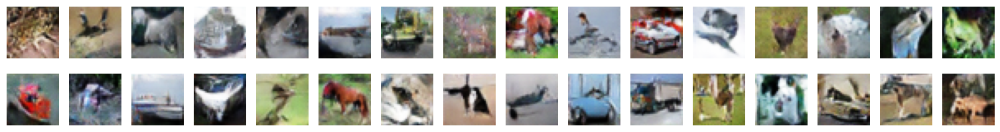

[171/250][150/391]	Loss_D: 0.2208	Loss_G: 4.1183	D(x): 3.0753	D(G(z)): -3.4205 / -4.0726
[171/250][300/391]	Loss_D: 0.3318	Loss_G: 4.5467	D(x): 3.6861	D(G(z)): -2.0885 / -4.5271
[172/250][150/391]	Loss_D: 0.4142	Loss_G: 2.5900	D(x): 1.7748	D(G(z)): -3.3685 / -2.4140
[172/250][300/391]	Loss_D: 0.2979	Loss_G: 4.5195	D(x): 3.8492	D(G(z)): -2.3593 / -4.4897
[173/250][150/391]	Loss_D: 0.2878	Loss_G: 4.7490	D(x): 3.1131	D(G(z)): -2.9475 / -4.7291
[173/250][300/391]	Loss_D: 0.3283	Loss_G: 4.0898	D(x): 3.7627	D(G(z)): -2.3108 / -4.0513
[174/250][150/391]	Loss_D: 0.2395	Loss_G: 3.6373	D(x): 2.9725	D(G(z)): -3.1417 / -3.5718
[174/250][300/391]	Loss_D: 0.2087	Loss_G: 3.8031	D(x): 3.0121	D(G(z)): -3.4828 / -3.7468
[175/250][150/391]	Loss_D: 0.3448	Loss_G: 3.8654	D(x): 2.6039	D(G(z)): -2.4081 / -3.8227
[175/250][300/391]	Loss_D: 0.6980	Loss_G: 6.2915	D(x): 5.0981	D(G(z)): -0.8484 / -6.2882


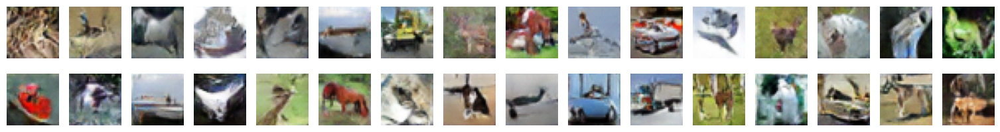

[176/250][150/391]	Loss_D: 0.5244	Loss_G: 1.8884	D(x): 1.1712	D(G(z)): -4.3105 / -1.3920
[176/250][300/391]	Loss_D: 0.3457	Loss_G: 2.9908	D(x): 1.5950	D(G(z)): -4.2463 / -2.8614
[177/250][150/391]	Loss_D: 0.3090	Loss_G: 3.4750	D(x): 1.8430	D(G(z)): -4.3992 / -3.3775
[177/250][300/391]	Loss_D: 0.1834	Loss_G: 3.8797	D(x): 2.8629	D(G(z)): -3.8926 / -3.8257
[178/250][150/391]	Loss_D: 0.3405	Loss_G: 3.4113	D(x): 1.7463	D(G(z)): -4.5633 / -3.3182
[178/250][300/391]	Loss_D: 0.2538	Loss_G: 5.1003	D(x): 3.6771	D(G(z)): -2.8281 / -5.0831
[179/250][150/391]	Loss_D: 0.3288	Loss_G: 4.0380	D(x): 2.7784	D(G(z)): -3.3007 / -3.9818
[179/250][300/391]	Loss_D: 0.2111	Loss_G: 4.0081	D(x): 3.0792	D(G(z)): -3.4427 / -3.9568
[180/250][150/391]	Loss_D: 0.2303	Loss_G: 3.8386	D(x): 2.5281	D(G(z)): -3.8822 / -3.7704
[180/250][300/391]	Loss_D: 0.3124	Loss_G: 4.7525	D(x): 3.7954	D(G(z)): -2.6323 / -4.7294


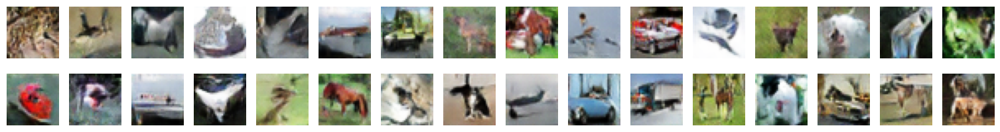

[181/250][150/391]	Loss_D: 0.3368	Loss_G: 2.6996	D(x): 1.9115	D(G(z)): -3.9329 / -2.5137
[181/250][300/391]	Loss_D: 0.4189	Loss_G: 4.6991	D(x): 3.2936	D(G(z)): -1.9719 / -4.6777
[182/250][150/391]	Loss_D: 0.1978	Loss_G: 4.3316	D(x): 3.4975	D(G(z)): -3.3891 / -4.2965
[182/250][300/391]	Loss_D: 0.2319	Loss_G: 3.6228	D(x): 2.4290	D(G(z)): -3.7850 / -3.5608
[183/250][150/391]	Loss_D: 0.2937	Loss_G: 3.9230	D(x): 2.4134	D(G(z)): -3.6863 / -3.8659
[183/250][300/391]	Loss_D: 0.2867	Loss_G: 4.0370	D(x): 2.4550	D(G(z)): -3.3662 / -3.9904
[184/250][150/391]	Loss_D: 0.2070	Loss_G: 3.8116	D(x): 2.9008	D(G(z)): -3.4338 / -3.7561
[184/250][300/391]	Loss_D: 0.4915	Loss_G: 5.6818	D(x): 4.2179	D(G(z)): -1.6528 / -5.6716
[185/250][150/391]	Loss_D: 0.2748	Loss_G: 3.4412	D(x): 2.3617	D(G(z)): -3.6921 / -3.3478
[185/250][300/391]	Loss_D: 0.2934	Loss_G: 5.3549	D(x): 3.2953	D(G(z)): -2.8220 / -5.3436


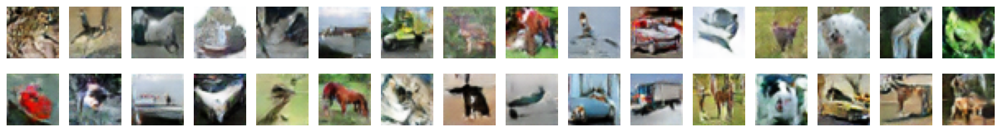

[186/250][150/391]	Loss_D: 0.2222	Loss_G: 5.3427	D(x): 4.1678	D(G(z)): -2.9717 / -5.3263
[186/250][300/391]	Loss_D: 0.3130	Loss_G: 3.7478	D(x): 1.9513	D(G(z)): -4.3281 / -3.6811
[187/250][150/391]	Loss_D: 0.2251	Loss_G: 4.7122	D(x): 3.4395	D(G(z)): -3.2437 / -4.6887
[187/250][300/391]	Loss_D: 0.1905	Loss_G: 4.7961	D(x): 3.3854	D(G(z)): -3.8580 / -4.7663
[188/250][150/391]	Loss_D: 0.2011	Loss_G: 3.8766	D(x): 2.9877	D(G(z)): -3.5315 / -3.8250
[188/250][300/391]	Loss_D: 0.1665	Loss_G: 4.3059	D(x): 2.9685	D(G(z)): -3.9836 / -4.2698
[189/250][150/391]	Loss_D: 0.1816	Loss_G: 4.5029	D(x): 3.8235	D(G(z)): -3.3475 / -4.4702
[189/250][300/391]	Loss_D: 0.3936	Loss_G: 2.8866	D(x): 1.6159	D(G(z)): -4.3035 / -2.6807
[190/250][150/391]	Loss_D: 0.2999	Loss_G: 3.2078	D(x): 2.3643	D(G(z)): -3.6199 / -3.0746
[190/250][300/391]	Loss_D: 0.3415	Loss_G: 5.0959	D(x): 3.6171	D(G(z)): -2.3091 / -5.0816


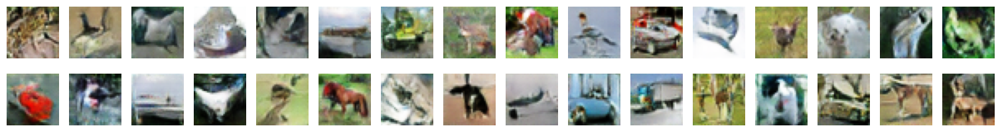

[191/250][150/391]	Loss_D: 0.1890	Loss_G: 4.4316	D(x): 3.9114	D(G(z)): -3.4743 / -4.3950
[191/250][300/391]	Loss_D: 0.2435	Loss_G: 4.0476	D(x): 2.8747	D(G(z)): -4.0140 / -3.9905
[192/250][150/391]	Loss_D: 0.2301	Loss_G: 4.0120	D(x): 2.8495	D(G(z)): -3.7586 / -3.9684
[192/250][300/391]	Loss_D: 0.3086	Loss_G: 3.3088	D(x): 2.3703	D(G(z)): -3.4999 / -3.2053
[193/250][150/391]	Loss_D: 0.2720	Loss_G: 3.1206	D(x): 2.1626	D(G(z)): -4.3601 / -2.9891
[193/250][300/391]	Loss_D: 0.2284	Loss_G: 4.6934	D(x): 3.5632	D(G(z)): -3.1548 / -4.6656
[194/250][150/391]	Loss_D: 0.2816	Loss_G: 4.7604	D(x): 3.0509	D(G(z)): -3.1740 / -4.7356
[194/250][300/391]	Loss_D: 0.2400	Loss_G: 4.7216	D(x): 3.3366	D(G(z)): -3.4537 / -4.6955
[195/250][150/391]	Loss_D: 0.2715	Loss_G: 3.5230	D(x): 2.2211	D(G(z)): -4.3540 / -3.4275
[195/250][300/391]	Loss_D: 0.1685	Loss_G: 4.9163	D(x): 3.3158	D(G(z)): -4.1016 / -4.8966


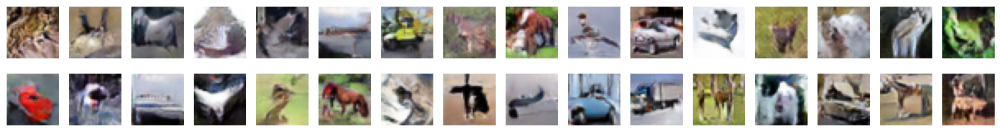

[196/250][150/391]	Loss_D: 0.3777	Loss_G: 3.7004	D(x): 2.2912	D(G(z)): -3.7563 / -3.6273
[196/250][300/391]	Loss_D: 0.1827	Loss_G: 5.0624	D(x): 4.2151	D(G(z)): -3.1846 / -5.0440
[197/250][150/391]	Loss_D: 0.1558	Loss_G: 5.0879	D(x): 3.6681	D(G(z)): -3.6317 / -5.0699
[197/250][300/391]	Loss_D: 0.6534	Loss_G: 6.4095	D(x): 4.2101	D(G(z)): -1.5170 / -6.4002
[198/250][150/391]	Loss_D: 0.2131	Loss_G: 4.9523	D(x): 3.7890	D(G(z)): -3.1763 / -4.9239
[198/250][300/391]	Loss_D: 0.2114	Loss_G: 4.2555	D(x): 2.9866	D(G(z)): -3.3256 / -4.2178
[199/250][150/391]	Loss_D: 0.2315	Loss_G: 4.6044	D(x): 3.8464	D(G(z)): -3.0393 / -4.5753
[199/250][300/391]	Loss_D: 0.2027	Loss_G: 5.1252	D(x): 2.6692	D(G(z)): -5.1987 / -5.1069
[200/250][150/391]	Loss_D: 0.2524	Loss_G: 3.5107	D(x): 2.1317	D(G(z)): -4.8715 / -3.4154
[200/250][300/391]	Loss_D: 0.2420	Loss_G: 5.1621	D(x): 4.6783	D(G(z)): -2.8641 / -5.1472


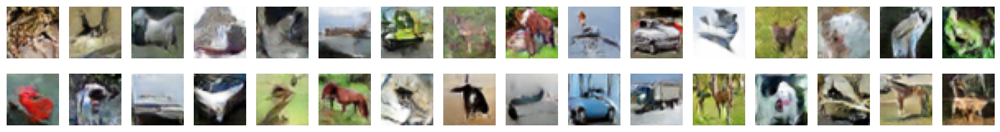

[201/250][150/391]	Loss_D: 0.1257	Loss_G: 4.9320	D(x): 3.9723	D(G(z)): -3.9749 / -4.9103
[201/250][300/391]	Loss_D: 0.2914	Loss_G: 5.7142	D(x): 3.7773	D(G(z)): -2.7601 / -5.7024
[202/250][150/391]	Loss_D: 0.1582	Loss_G: 4.8370	D(x): 3.6587	D(G(z)): -4.0036 / -4.8141
[202/250][300/391]	Loss_D: 0.1974	Loss_G: 4.0187	D(x): 2.8667	D(G(z)): -4.3670 / -3.9701
[203/250][150/391]	Loss_D: 0.2213	Loss_G: 4.4847	D(x): 3.0322	D(G(z)): -3.9683 / -4.4438
[203/250][300/391]	Loss_D: 0.2624	Loss_G: 4.9974	D(x): 3.8949	D(G(z)): -3.0948 / -4.9808
[204/250][150/391]	Loss_D: 0.1899	Loss_G: 4.7257	D(x): 4.2457	D(G(z)): -3.2720 / -4.7058
[204/250][300/391]	Loss_D: 0.1523	Loss_G: 4.9817	D(x): 3.6866	D(G(z)): -4.2109 / -4.9556
[205/250][150/391]	Loss_D: 0.2082	Loss_G: 4.7539	D(x): 4.0796	D(G(z)): -3.3462 / -4.7271
[205/250][300/391]	Loss_D: 0.1447	Loss_G: 5.3329	D(x): 4.1186	D(G(z)): -3.7828 / -5.3203


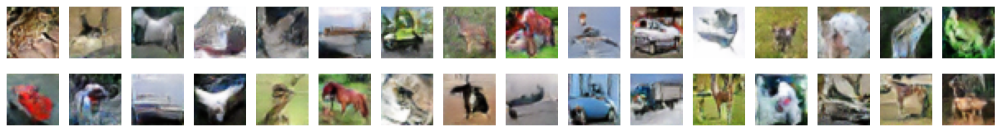

[206/250][150/391]	Loss_D: 0.1408	Loss_G: 5.3412	D(x): 3.9643	D(G(z)): -3.8836 / -5.3274
[206/250][300/391]	Loss_D: 0.1773	Loss_G: 5.4432	D(x): 3.8729	D(G(z)): -3.6029 / -5.4296
[207/250][150/391]	Loss_D: 0.2320	Loss_G: 4.9011	D(x): 2.4832	D(G(z)): -4.7894 / -4.8755
[207/250][300/391]	Loss_D: 0.2184	Loss_G: 4.8350	D(x): 3.3669	D(G(z)): -3.5994 / -4.8089
[208/250][150/391]	Loss_D: 0.5618	Loss_G: 3.8101	D(x): 2.1426	D(G(z)): -3.4681 / -3.7254
[208/250][300/391]	Loss_D: 0.2474	Loss_G: 4.1762	D(x): 3.7922	D(G(z)): -3.0633 / -4.1403
[209/250][150/391]	Loss_D: 0.1366	Loss_G: 5.1181	D(x): 4.1949	D(G(z)): -3.8530 / -5.0992
[209/250][300/391]	Loss_D: 0.1356	Loss_G: 4.7205	D(x): 3.5474	D(G(z)): -4.2615 / -4.6872
[210/250][150/391]	Loss_D: 0.1632	Loss_G: 5.4499	D(x): 4.0546	D(G(z)): -3.8141 / -5.4345
[210/250][300/391]	Loss_D: 0.1560	Loss_G: 4.6180	D(x): 3.5079	D(G(z)): -4.1259 / -4.5844


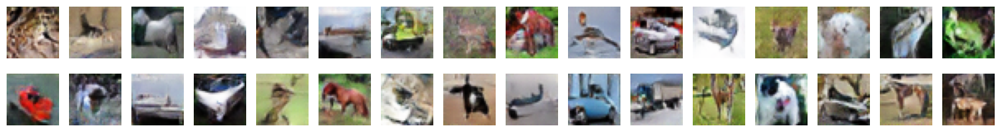

[211/250][150/391]	Loss_D: 0.1973	Loss_G: 4.4974	D(x): 3.1336	D(G(z)): -4.7071 / -4.4545
[211/250][300/391]	Loss_D: 0.1757	Loss_G: 4.9088	D(x): 3.4486	D(G(z)): -3.9695 / -4.8870
[212/250][150/391]	Loss_D: 0.1687	Loss_G: 4.6822	D(x): 4.2328	D(G(z)): -3.2461 / -4.6589
[212/250][300/391]	Loss_D: 0.4538	Loss_G: 3.3704	D(x): 1.7506	D(G(z)): -6.4080 / -3.2139
[213/250][150/391]	Loss_D: 0.1868	Loss_G: 3.7690	D(x): 2.8392	D(G(z)): -4.5357 / -3.7055
[213/250][300/391]	Loss_D: 0.2178	Loss_G: 3.8277	D(x): 3.0778	D(G(z)): -4.1373 / -3.7606
[214/250][150/391]	Loss_D: 0.2707	Loss_G: 4.2257	D(x): 2.3847	D(G(z)): -4.7080 / -4.1585
[214/250][300/391]	Loss_D: 0.1985	Loss_G: 3.7244	D(x): 3.2186	D(G(z)): -4.1628 / -3.6646
[215/250][150/391]	Loss_D: 0.1659	Loss_G: 5.0257	D(x): 3.1570	D(G(z)): -4.8352 / -4.9957
[215/250][300/391]	Loss_D: 0.1946	Loss_G: 4.7061	D(x): 3.5580	D(G(z)): -3.6235 / -4.6841


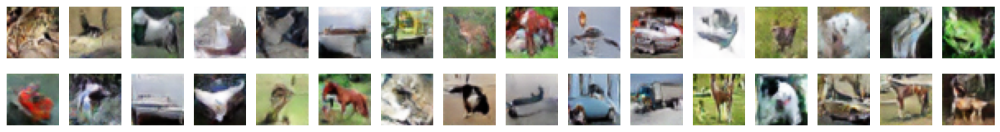

[216/250][150/391]	Loss_D: 0.2227	Loss_G: 5.1053	D(x): 4.1287	D(G(z)): -3.2066 / -5.0890
[216/250][300/391]	Loss_D: 0.2626	Loss_G: 3.1634	D(x): 2.7299	D(G(z)): -4.9043 / -2.9931
[217/250][150/391]	Loss_D: 0.1454	Loss_G: 5.1005	D(x): 4.2106	D(G(z)): -3.9923 / -5.0811
[217/250][300/391]	Loss_D: 0.2177	Loss_G: 5.1751	D(x): 4.3266	D(G(z)): -4.0897 / -5.1484
[218/250][150/391]	Loss_D: 0.1486	Loss_G: 5.3361	D(x): 3.6824	D(G(z)): -4.4213 / -5.3164
[218/250][300/391]	Loss_D: 0.1444	Loss_G: 5.0507	D(x): 3.7639	D(G(z)): -4.2888 / -5.0299
[219/250][150/391]	Loss_D: 0.1981	Loss_G: 5.3588	D(x): 3.4794	D(G(z)): -4.1550 / -5.3412
[219/250][300/391]	Loss_D: 0.3881	Loss_G: 7.1069	D(x): 3.9345	D(G(z)): -2.7893 / -7.1046
[220/250][150/391]	Loss_D: 0.1694	Loss_G: 5.6946	D(x): 3.7021	D(G(z)): -4.1584 / -5.6781
[220/250][300/391]	Loss_D: 0.1524	Loss_G: 4.7062	D(x): 3.8829	D(G(z)): -4.2549 / -4.6636


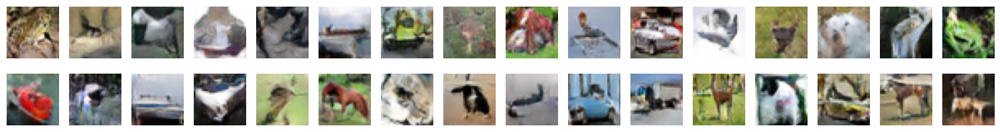

[221/250][150/391]	Loss_D: 0.1371	Loss_G: 5.1894	D(x): 3.8453	D(G(z)): -4.3953 / -5.1681
[221/250][300/391]	Loss_D: 0.6273	Loss_G: 4.8899	D(x): 2.8144	D(G(z)): -3.5175 / -4.8328
[222/250][150/391]	Loss_D: 0.1784	Loss_G: 4.9750	D(x): 4.4283	D(G(z)): -3.4638 / -4.9532
[222/250][300/391]	Loss_D: 0.1475	Loss_G: 4.7533	D(x): 3.1960	D(G(z)): -4.7103 / -4.7200
[223/250][150/391]	Loss_D: 0.1778	Loss_G: 4.1580	D(x): 3.0958	D(G(z)): -4.6073 / -4.0956
[223/250][300/391]	Loss_D: 0.1450	Loss_G: 4.5750	D(x): 3.0554	D(G(z)): -4.7503 / -4.5324
[224/250][150/391]	Loss_D: 0.1136	Loss_G: 5.5786	D(x): 3.7876	D(G(z)): -4.9570 / -5.5587
[224/250][300/391]	Loss_D: 0.2359	Loss_G: 4.3755	D(x): 2.8561	D(G(z)): -4.4575 / -4.3234
[225/250][150/391]	Loss_D: 0.2705	Loss_G: 4.2117	D(x): 2.3616	D(G(z)): -5.4573 / -4.1403
[225/250][300/391]	Loss_D: 0.0959	Loss_G: 4.6441	D(x): 4.0034	D(G(z)): -4.2835 / -4.6184


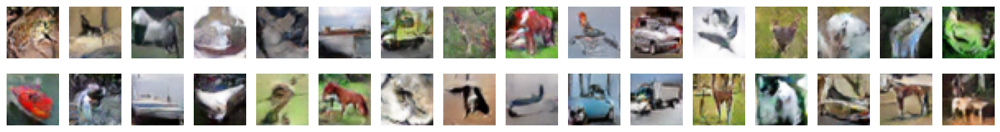

[226/250][150/391]	Loss_D: 0.1411	Loss_G: 4.6835	D(x): 3.2054	D(G(z)): -4.6546 / -4.6469
[226/250][300/391]	Loss_D: 0.1514	Loss_G: 5.4534	D(x): 3.5207	D(G(z)): -4.8691 / -5.4318
[227/250][150/391]	Loss_D: 0.1333	Loss_G: 5.2148	D(x): 3.8811	D(G(z)): -4.7046 / -5.1938
[227/250][300/391]	Loss_D: 0.1514	Loss_G: 5.6163	D(x): 4.7133	D(G(z)): -3.6776 / -5.6053
[228/250][150/391]	Loss_D: 0.2549	Loss_G: 5.2770	D(x): 3.1967	D(G(z)): -5.1952 / -5.2451
[228/250][300/391]	Loss_D: 0.2649	Loss_G: 6.1027	D(x): 4.6791	D(G(z)): -3.5314 / -6.0956
[229/250][150/391]	Loss_D: 0.1498	Loss_G: 6.0729	D(x): 4.6322	D(G(z)): -4.0663 / -6.0590
[229/250][300/391]	Loss_D: 0.1582	Loss_G: 5.8239	D(x): 3.9115	D(G(z)): -4.5806 / -5.8100
[230/250][150/391]	Loss_D: 0.1692	Loss_G: 5.5128	D(x): 4.1169	D(G(z)): -4.2063 / -5.4957
[230/250][300/391]	Loss_D: 0.1960	Loss_G: 4.3808	D(x): 3.1795	D(G(z)): -4.1561 / -4.3448


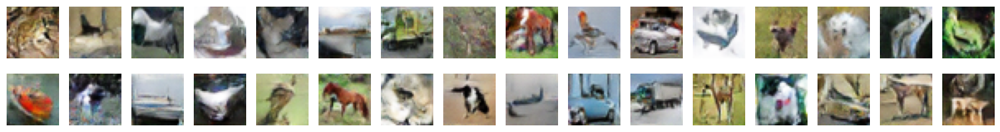

[231/250][150/391]	Loss_D: 0.1430	Loss_G: 4.5406	D(x): 3.2814	D(G(z)): -5.1323 / -4.4891
[231/250][300/391]	Loss_D: 0.1068	Loss_G: 5.2577	D(x): 4.8149	D(G(z)): -4.2715 / -5.2380
[232/250][150/391]	Loss_D: 0.1171	Loss_G: 4.9978	D(x): 3.9254	D(G(z)): -4.7223 / -4.9687
[232/250][300/391]	Loss_D: 0.1864	Loss_G: 4.8183	D(x): 2.7802	D(G(z)): -5.3508 / -4.7669
[233/250][150/391]	Loss_D: 0.1446	Loss_G: 5.3082	D(x): 4.1608	D(G(z)): -4.1726 / -5.2899
[233/250][300/391]	Loss_D: 0.1049	Loss_G: 5.9441	D(x): 5.6645	D(G(z)): -4.2894 / -5.9333
[234/250][150/391]	Loss_D: 0.1276	Loss_G: 4.8734	D(x): 3.5493	D(G(z)): -5.2116 / -4.8479
[234/250][300/391]	Loss_D: 0.1328	Loss_G: 4.9531	D(x): 3.0010	D(G(z)): -6.0351 / -4.9175
[235/250][150/391]	Loss_D: 0.1265	Loss_G: 6.3480	D(x): 4.3949	D(G(z)): -4.9908 / -6.3381
[235/250][300/391]	Loss_D: 0.2261	Loss_G: 6.6267	D(x): 5.6621	D(G(z)): -2.9970 / -6.6228


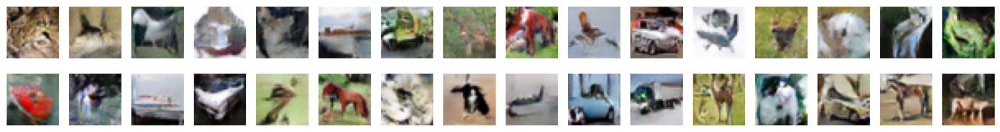

[236/250][150/391]	Loss_D: 0.2079	Loss_G: 4.0735	D(x): 3.3200	D(G(z)): -4.4356 / -4.0107
[236/250][300/391]	Loss_D: 0.0899	Loss_G: 5.8764	D(x): 4.7340	D(G(z)): -5.3222 / -5.8632
[237/250][150/391]	Loss_D: 0.1883	Loss_G: 4.9725	D(x): 4.1151	D(G(z)): -4.4930 / -4.9444
[237/250][300/391]	Loss_D: 0.3629	Loss_G: 6.9242	D(x): 5.7758	D(G(z)): -2.6761 / -6.9205
[238/250][150/391]	Loss_D: 0.1680	Loss_G: 5.8815	D(x): 4.2863	D(G(z)): -4.3893 / -5.8692
[238/250][300/391]	Loss_D: 0.1742	Loss_G: 5.7629	D(x): 3.9019	D(G(z)): -4.4532 / -5.7494
[239/250][150/391]	Loss_D: 0.1448	Loss_G: 4.7109	D(x): 3.3189	D(G(z)): -5.7655 / -4.6528
[239/250][300/391]	Loss_D: 0.2139	Loss_G: 5.2784	D(x): 3.3742	D(G(z)): -4.6973 / -5.2480
[240/250][150/391]	Loss_D: 0.1355	Loss_G: 5.0472	D(x): 4.1192	D(G(z)): -4.2803 / -5.0247
[240/250][300/391]	Loss_D: 0.1095	Loss_G: 4.8358	D(x): 3.6302	D(G(z)): -5.2969 / -4.8028


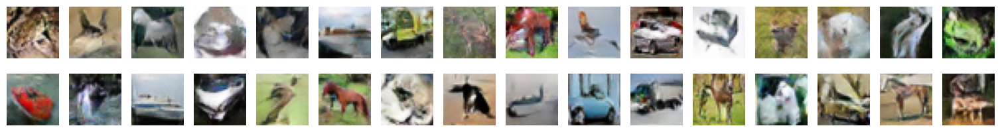

[241/250][150/391]	Loss_D: 0.1012	Loss_G: 5.8160	D(x): 4.1965	D(G(z)): -5.1774 / -5.8024
[241/250][300/391]	Loss_D: 0.1884	Loss_G: 6.5235	D(x): 4.0135	D(G(z)): -4.5804 / -6.5135
[242/250][150/391]	Loss_D: 0.1959	Loss_G: 3.9417	D(x): 2.9856	D(G(z)): -5.8235 / -3.8442
[242/250][300/391]	Loss_D: 0.2667	Loss_G: 7.0330	D(x): 4.4864	D(G(z)): -3.5299 / -7.0287
[243/250][150/391]	Loss_D: 0.0944	Loss_G: 5.1646	D(x): 5.1772	D(G(z)): -4.1438 / -5.1485
[243/250][300/391]	Loss_D: 0.1670	Loss_G: 4.8308	D(x): 3.1072	D(G(z)): -5.9764 / -4.7912
[244/250][150/391]	Loss_D: 0.1108	Loss_G: 5.1285	D(x): 3.7294	D(G(z)): -5.5215 / -5.1000
[244/250][300/391]	Loss_D: 0.2265	Loss_G: 3.7462	D(x): 2.6901	D(G(z)): -5.7712 / -3.6424
[245/250][150/391]	Loss_D: 0.2821	Loss_G: 7.5762	D(x): 5.6905	D(G(z)): -2.7486 / -7.5734
[245/250][300/391]	Loss_D: 7.9004	Loss_G: 0.7661	D(x): -7.8421	D(G(z)): -13.8379 / 3.0832


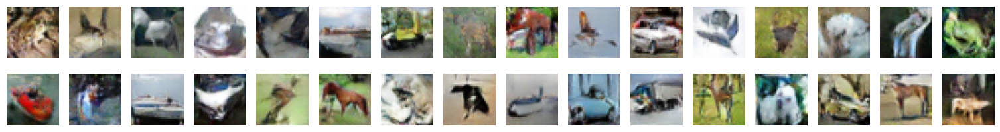

[246/250][150/391]	Loss_D: 0.0915	Loss_G: 5.7698	D(x): 4.0520	D(G(z)): -5.4656 / -5.7553
[246/250][300/391]	Loss_D: 0.1393	Loss_G: 4.8916	D(x): 3.1040	D(G(z)): -5.4509 / -4.8531
[247/250][150/391]	Loss_D: 0.0768	Loss_G: 5.0253	D(x): 4.6192	D(G(z)): -5.0897 / -4.9996
[247/250][300/391]	Loss_D: 0.0883	Loss_G: 5.7078	D(x): 3.8588	D(G(z)): -5.1190 / -5.6935
[248/250][150/391]	Loss_D: 0.1129	Loss_G: 5.5057	D(x): 3.7247	D(G(z)): -5.3027 / -5.4794
[248/250][300/391]	Loss_D: 0.1428	Loss_G: 7.0301	D(x): 5.5805	D(G(z)): -4.0556 / -7.0247
[249/250][150/391]	Loss_D: 0.0970	Loss_G: 5.9838	D(x): 4.4218	D(G(z)): -4.7859 / -5.9707
[249/250][300/391]	Loss_D: 0.2573	Loss_G: 6.8033	D(x): 5.4953	D(G(z)): -3.2054 / -6.7985
[250/250][150/391]	Loss_D: 0.0621	Loss_G: 5.3984	D(x): 4.6810	D(G(z)): -5.1888 / -5.3816
[250/250][300/391]	Loss_D: 0.1461	Loss_G: 6.1370	D(x): 4.8450	D(G(z)): -4.2124 / -6.1272


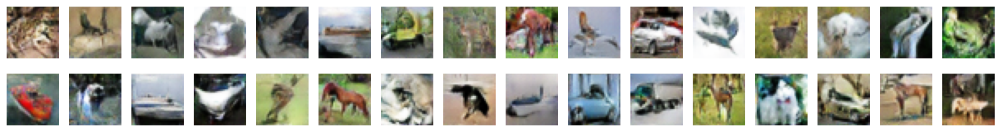

In [10]:
Utils.cGAN_train(netD, netG, optimizerD, optimizerG, criterion, dataloader,
                EPOCH_NUM, X_DIM, LATENT_DIM, viz_noise, viz_labels, device)

## Sample fake images

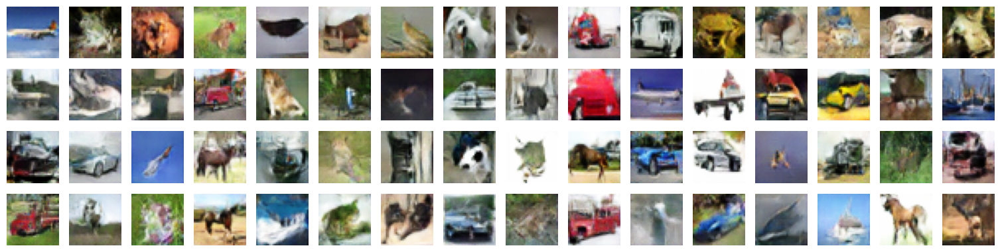

In [16]:
Utils.cgan_plot_fake(netG, viz_noise, viz_labels, X_DIM, cnt=64)

## Saving the model

In [15]:
class CGANExportWrapper(nn.Module):
    def __init__(self, netG, upsample_size=56):
        super().__init__()
        self.netG = netG
        self.upsample = nn.Upsample(size=upsample_size, mode='nearest')

    def forward(self, noise, labels):
        img = self.netG(noise, labels)
        return self.upsample(img)

model = CGANExportWrapper(netG, upsample_size=56).to(device)
dummy_noise = torch.randn(1, LATENT_DIM, 1, 1, device=device)
dummy_labels = torch.randint(0, NUM_CLASSES, (1,), device=device)
Utils.save_model(model, dummy_noise, dummy_labels=dummy_labels, name='cGAN_CIFAR10')